<a href="https://colab.research.google.com/github/SalarNouri/Advanced-Deep-Learning/blob/main/Learning/Generative%20Adversarial%20Networks/C1W4A_Build_a_Conditional_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [ ]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [ ]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [ ]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels of the output image, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [ ]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels,n_classes)
    #### END CODE HERE ####

In [ ]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [ ]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(),y.float()), 1)
    #### END CODE HERE ####
    return combined

In [ ]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [ ]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [ ]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [ ]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [ ]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [ ]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.3263947422504425, discriminator loss: 0.23965048154816032


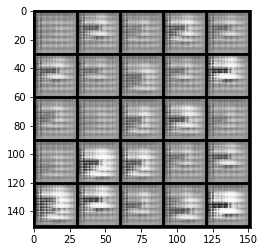

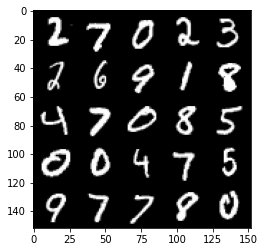

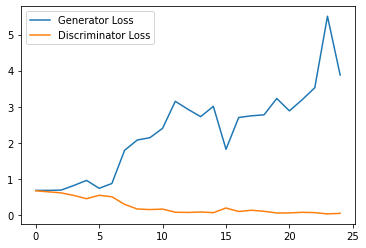

Step 1000: Generator loss: 4.687422085285187, discriminator loss: 0.04075012680795044


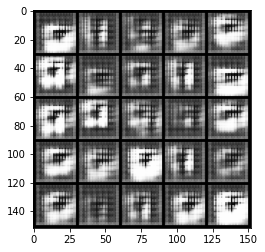

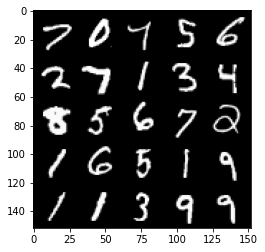

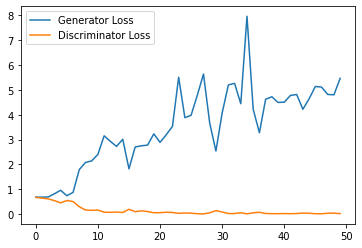

Step 1500: Generator loss: 4.548729343414307, discriminator loss: 0.04497962290234864


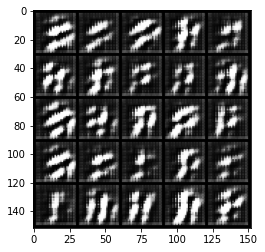

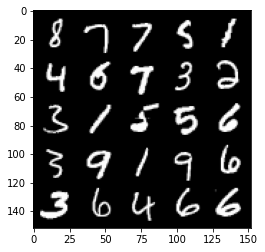

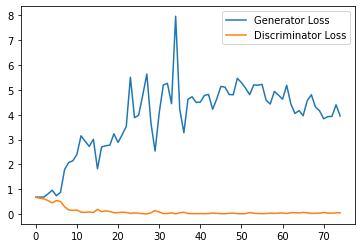

Step 2000: Generator loss: 4.0431579222679135, discriminator loss: 0.067906698230654


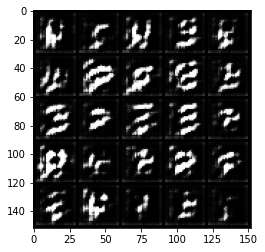

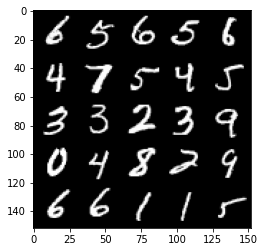

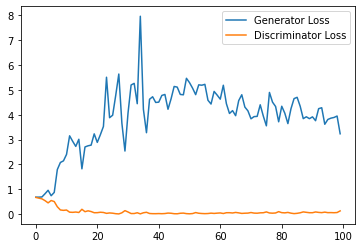

Step 2500: Generator loss: 3.171518041610718, discriminator loss: 0.16041214782744645


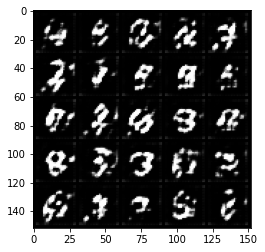

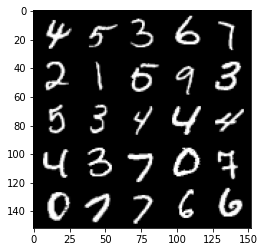

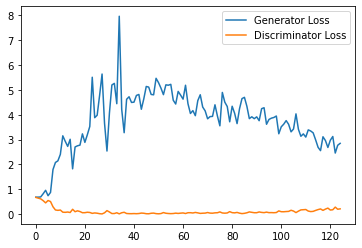

Step 3000: Generator loss: 2.7614971046447754, discriminator loss: 0.23068610513210297


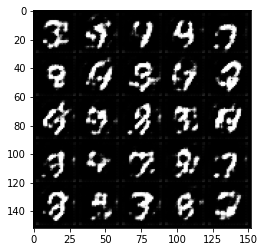

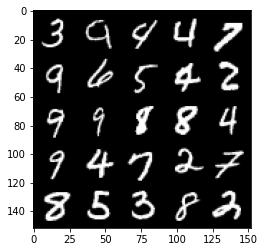

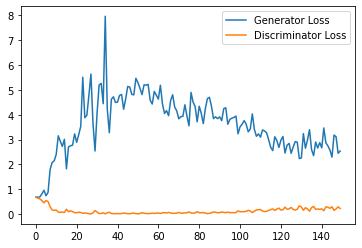

Step 3500: Generator loss: 2.4079681327342985, discriminator loss: 0.2777307085543871


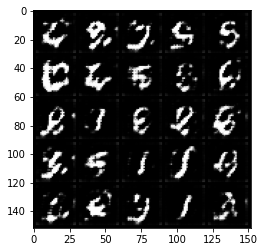

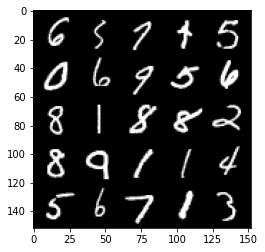

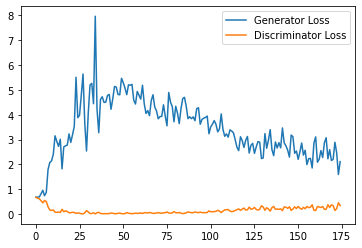

Step 4000: Generator loss: 2.0925510001182555, discriminator loss: 0.3078137553036213


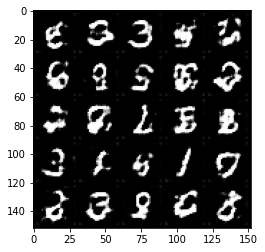

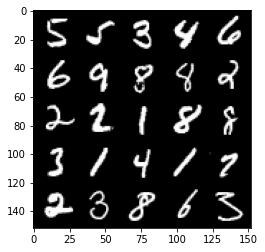

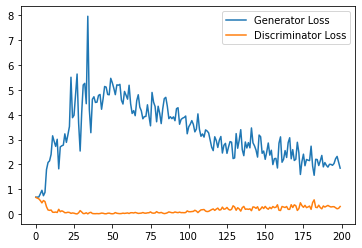

Step 4500: Generator loss: 2.0907456624507903, discriminator loss: 0.3349303421676159


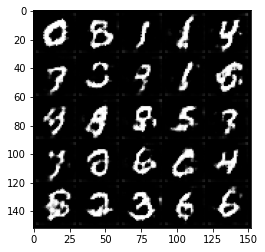

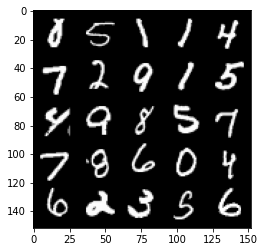

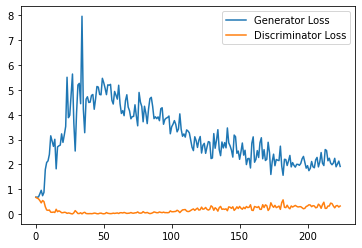

Step 5000: Generator loss: 1.947646274328232, discriminator loss: 0.3503646764159203


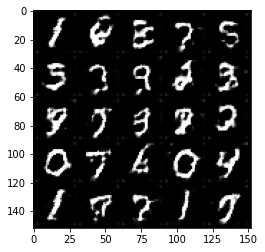

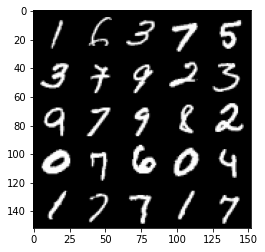

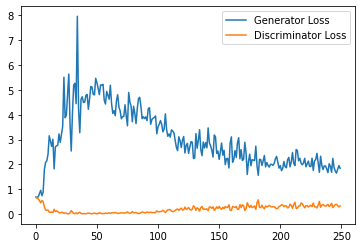

Step 5500: Generator loss: 1.8241453075408935, discriminator loss: 0.37080537793040275


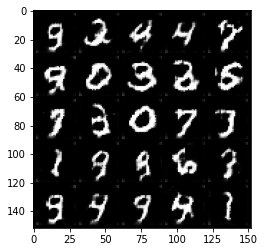

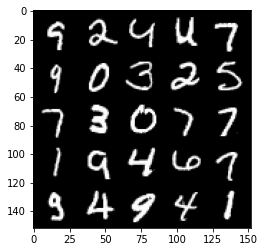

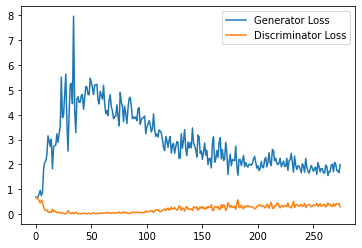

Step 6000: Generator loss: 1.7724980210065842, discriminator loss: 0.3917790184915066


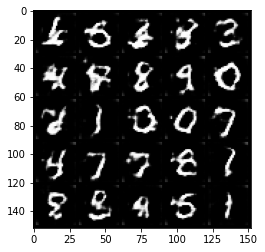

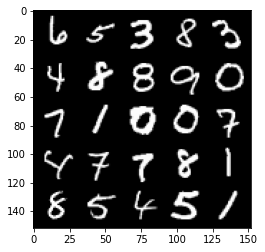

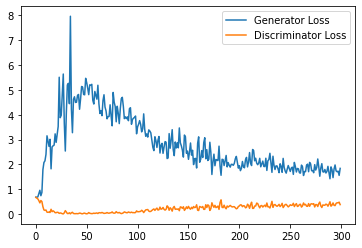

Step 6500: Generator loss: 1.7100134544372558, discriminator loss: 0.41617513564229014


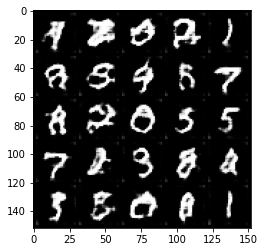

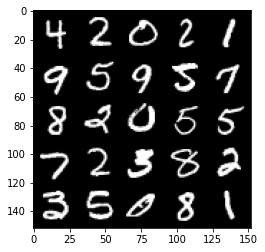

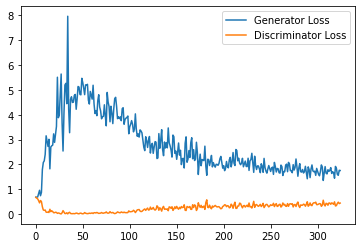

Step 7000: Generator loss: 1.5931898310184478, discriminator loss: 0.44597881656885147


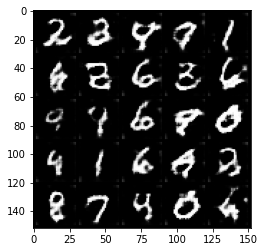

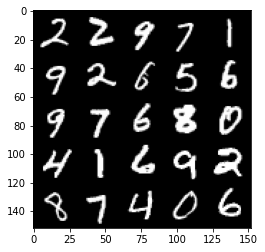

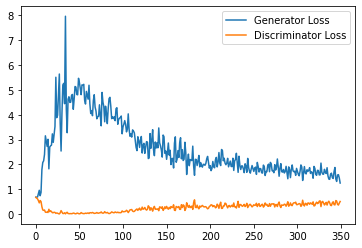

Step 7500: Generator loss: 1.5685437421798707, discriminator loss: 0.45953101643919947


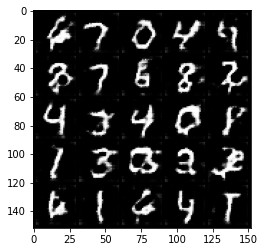

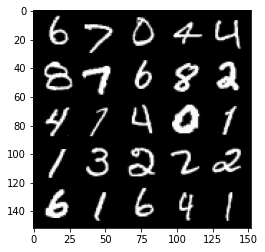

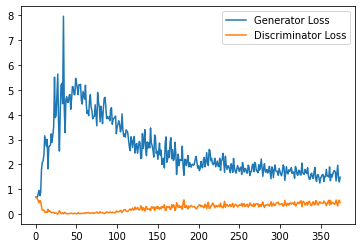

Step 8000: Generator loss: 1.4756343975067139, discriminator loss: 0.4679614228606224


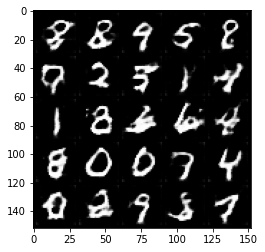

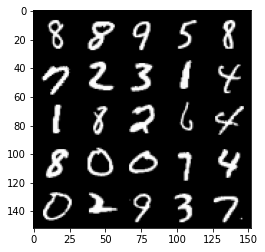

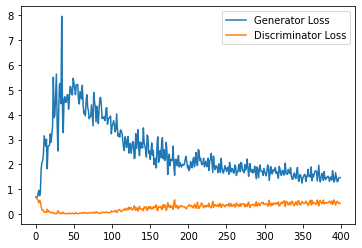

Step 8500: Generator loss: 1.4742711033821105, discriminator loss: 0.48215434968471527


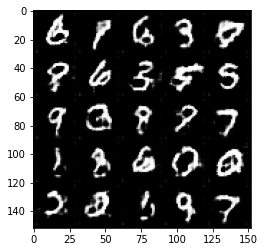

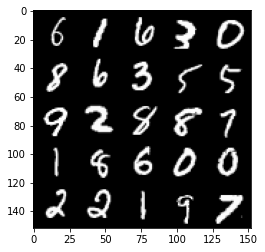

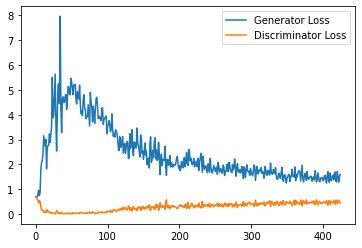

Step 9000: Generator loss: 1.3655861765146255, discriminator loss: 0.5048451467156411


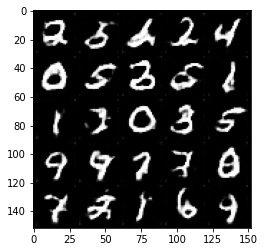

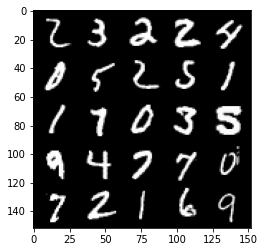

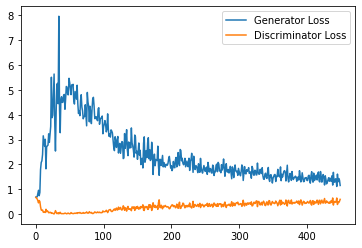

Step 9500: Generator loss: 1.3120538079738617, discriminator loss: 0.5121871746182441


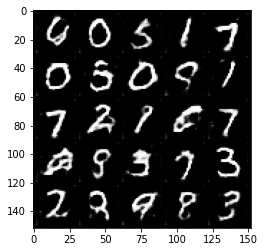

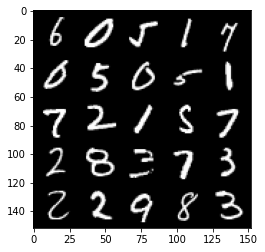

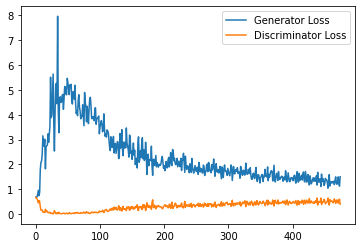

Step 10000: Generator loss: 1.291928228020668, discriminator loss: 0.5266815646290779


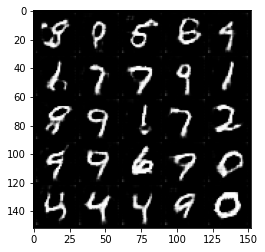

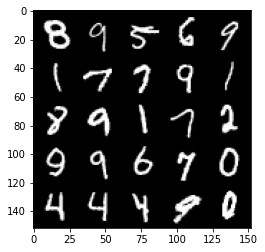

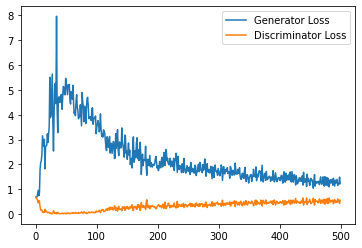

Step 10500: Generator loss: 1.2956871346235275, discriminator loss: 0.5355231951475143


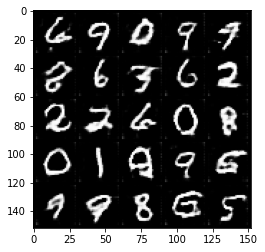

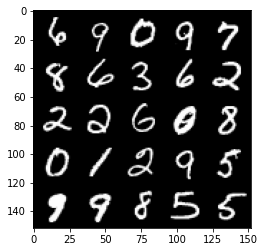

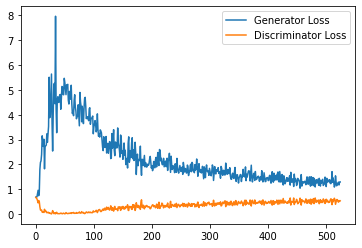

Step 11000: Generator loss: 1.2353127624988556, discriminator loss: 0.5424916272163391


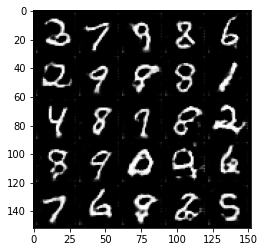

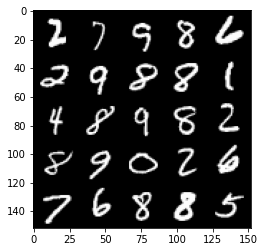

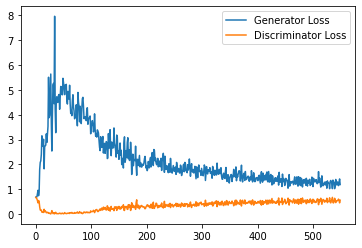

Step 11500: Generator loss: 1.1785477390289307, discriminator loss: 0.5452738304138184


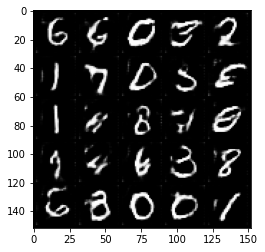

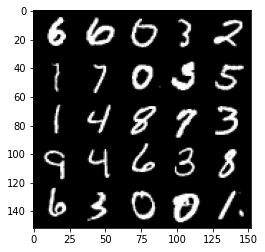

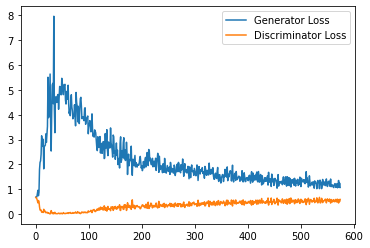

Step 12000: Generator loss: 1.199754550099373, discriminator loss: 0.5494908024668693


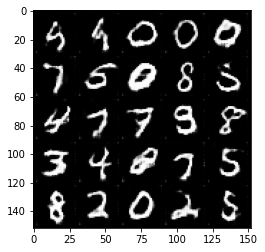

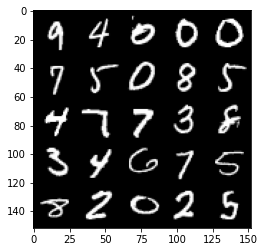

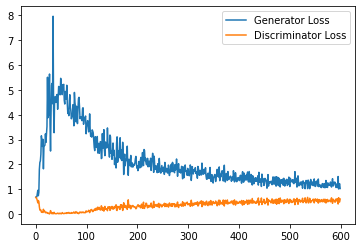

Step 12500: Generator loss: 1.1972226296663284, discriminator loss: 0.5595498148798943


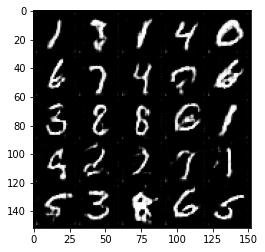

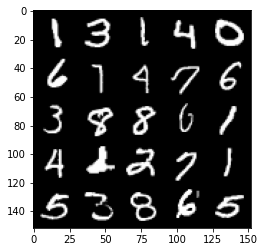

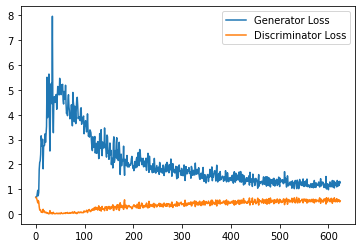

Step 13000: Generator loss: 1.1594136157035828, discriminator loss: 0.5725039094686508


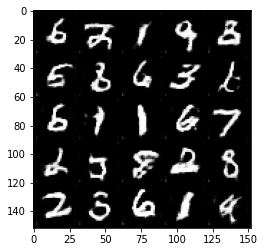

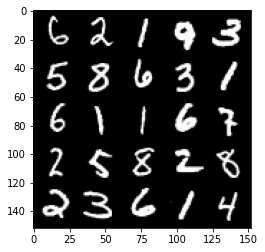

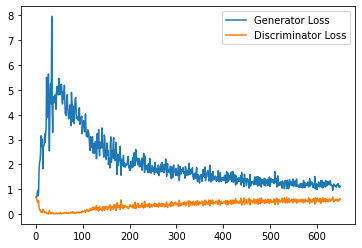

Step 13500: Generator loss: 1.1033387035131454, discriminator loss: 0.5768108270168304


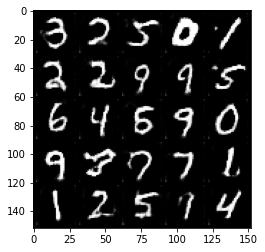

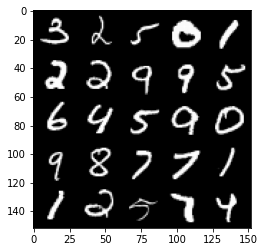

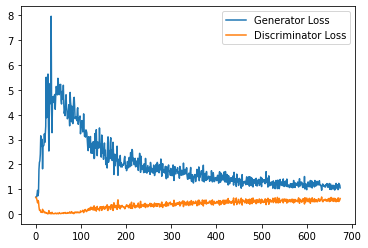

Step 14000: Generator loss: 1.1375335620641709, discriminator loss: 0.5735713847279549


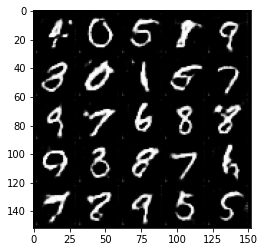

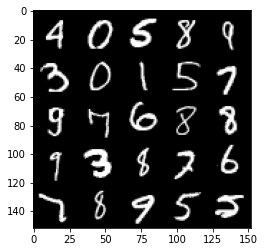

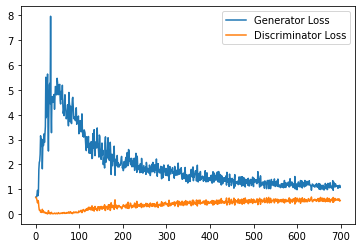

Step 14500: Generator loss: 1.1056058959960937, discriminator loss: 0.5635579906702042


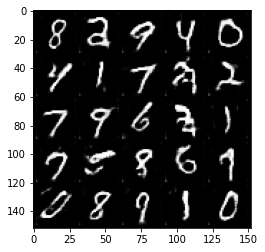

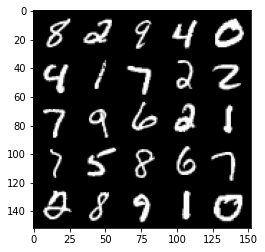

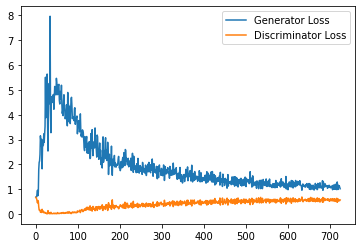

Step 15000: Generator loss: 1.1383200393915176, discriminator loss: 0.5684173634052276


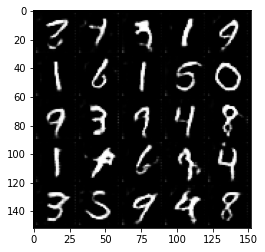

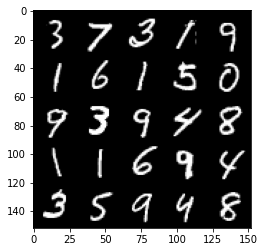

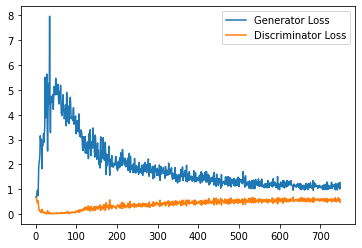

Step 15500: Generator loss: 1.105169523358345, discriminator loss: 0.5745764387249946


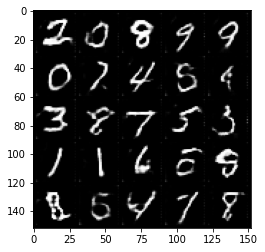

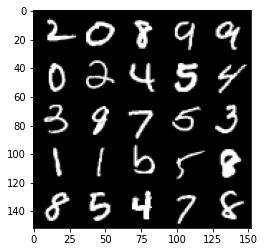

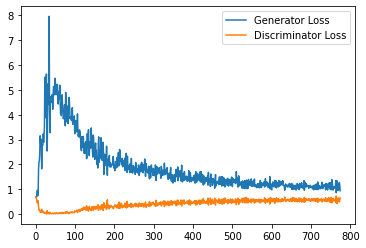

Step 16000: Generator loss: 1.104645124554634, discriminator loss: 0.5760877651572227


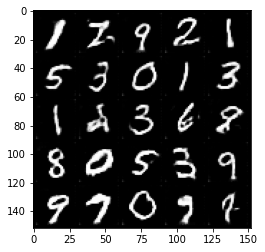

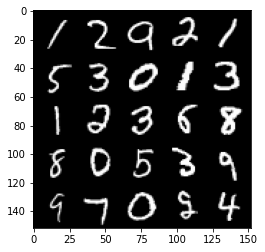

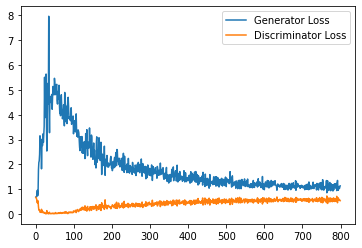

Step 16500: Generator loss: 1.0596887938976287, discriminator loss: 0.569583202958107


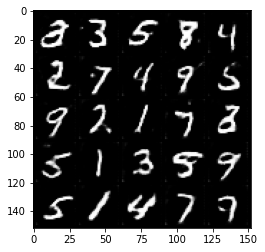

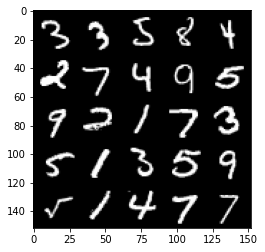

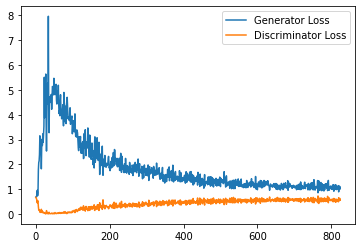

Step 17000: Generator loss: 1.103204645872116, discriminator loss: 0.5720725796818733


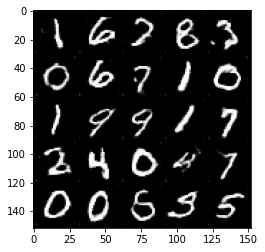

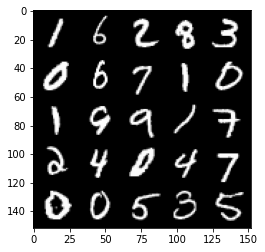

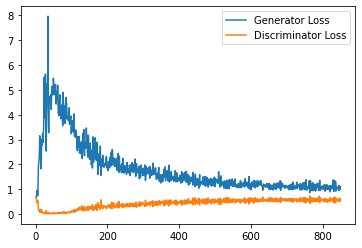

Step 17500: Generator loss: 1.0854702286720277, discriminator loss: 0.5695059090852738


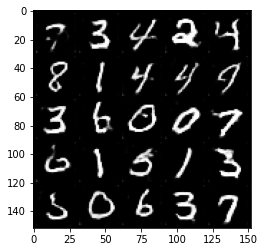

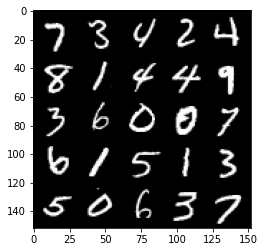

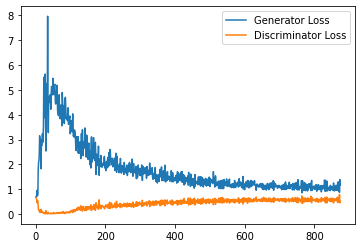

Step 18000: Generator loss: 1.0718028720617294, discriminator loss: 0.5757426726818085


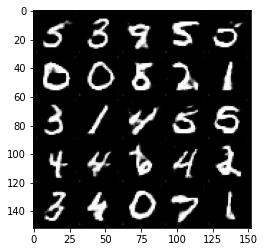

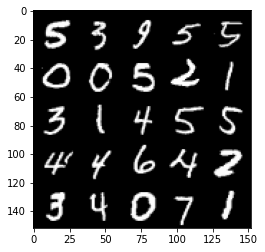

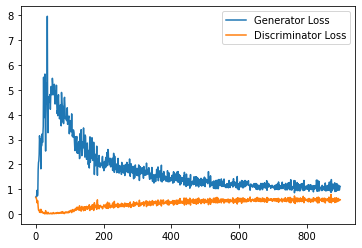

Step 18500: Generator loss: 1.1096580653190613, discriminator loss: 0.5711345753073692


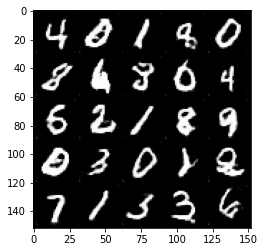

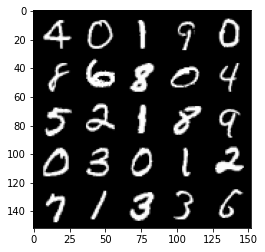

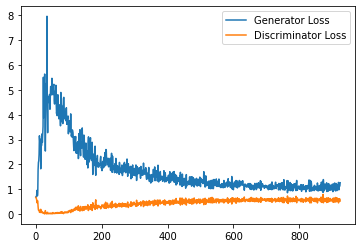

Step 19000: Generator loss: 1.0787392358779908, discriminator loss: 0.5742419267296791


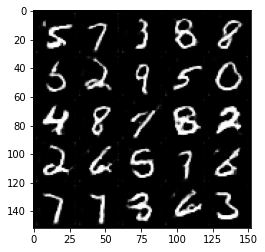

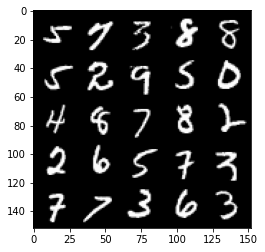

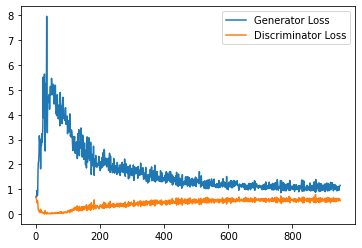

Step 19500: Generator loss: 1.0724397222995758, discriminator loss: 0.5813886637091636


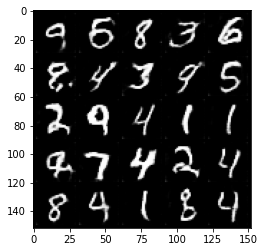

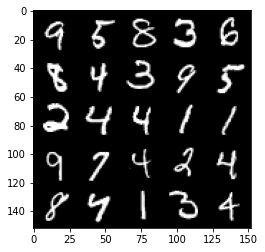

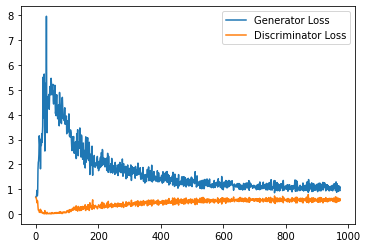

Step 20000: Generator loss: 1.0655865386724472, discriminator loss: 0.5798842411637306


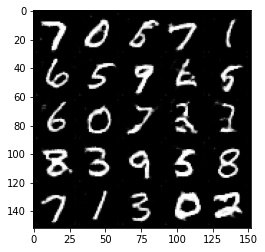

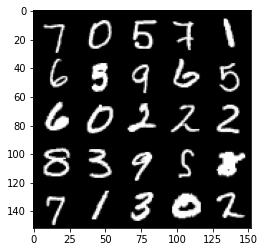

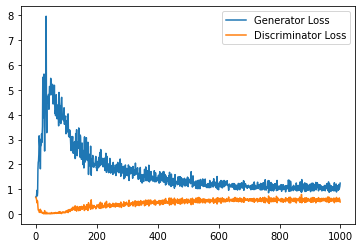

Step 20500: Generator loss: 1.0654167560338974, discriminator loss: 0.58039070135355


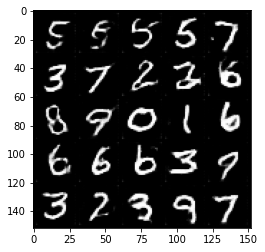

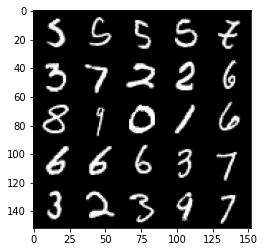

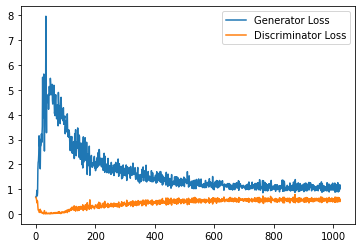

Step 21000: Generator loss: 1.0791396692991257, discriminator loss: 0.574463737308979


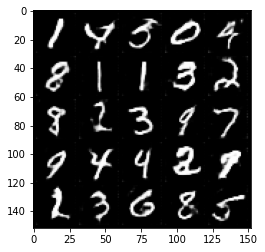

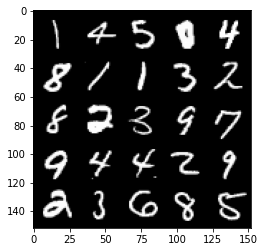

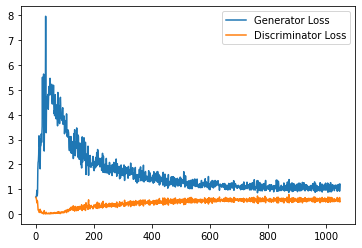

Step 21500: Generator loss: 1.0710498982667922, discriminator loss: 0.5898847787380218


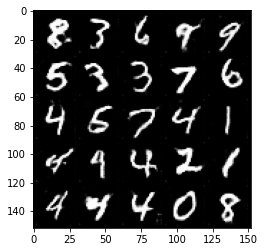

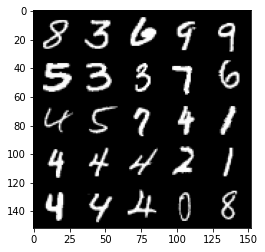

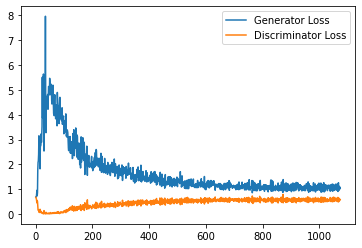

Step 22000: Generator loss: 1.0350088220834732, discriminator loss: 0.5821202031373978


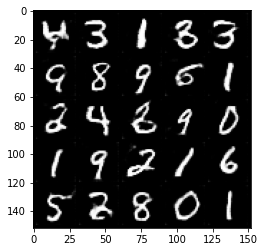

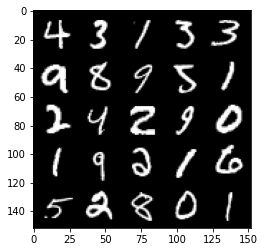

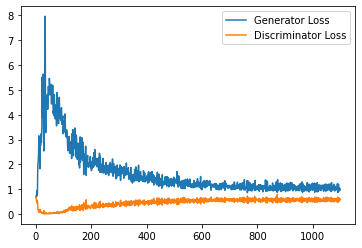

Step 22500: Generator loss: 1.0432008615732193, discriminator loss: 0.5896556507349014


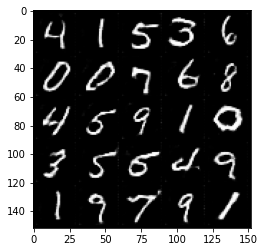

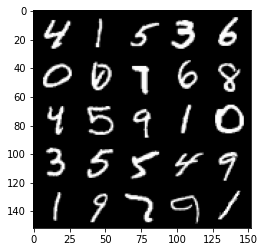

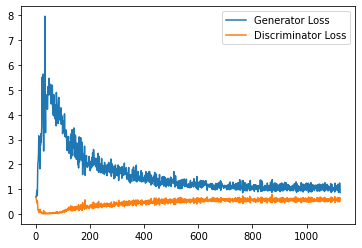

Step 23000: Generator loss: 1.0176817778348923, discriminator loss: 0.5871498165726662


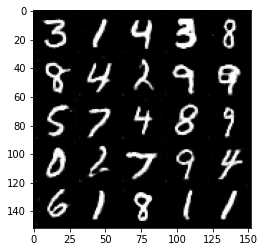

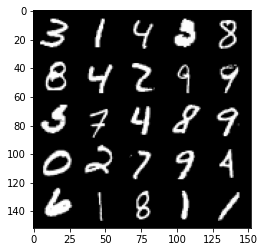

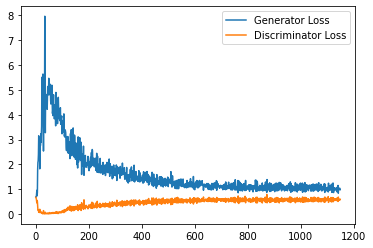

Step 23500: Generator loss: 1.0344758969545365, discriminator loss: 0.5956614663600922


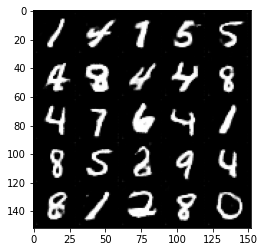

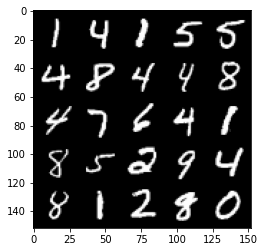

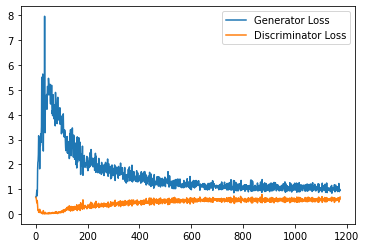

Step 24000: Generator loss: 1.0450630897283555, discriminator loss: 0.5865459679365158


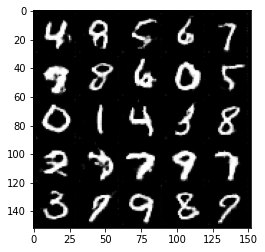

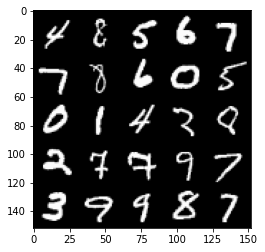

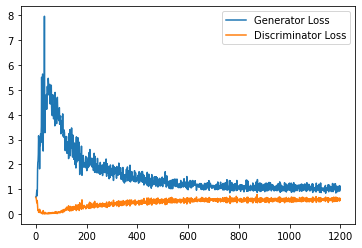

Step 24500: Generator loss: 1.084143264055252, discriminator loss: 0.5908677590489387


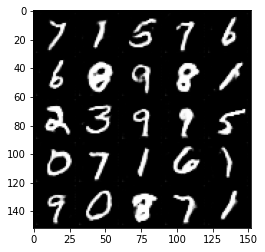

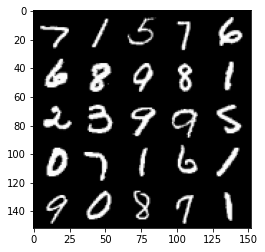

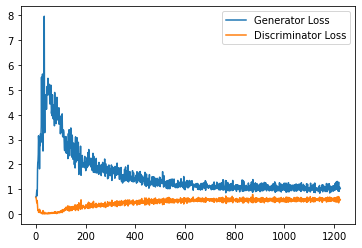

Step 25000: Generator loss: 1.0166375476121903, discriminator loss: 0.5923139347434044


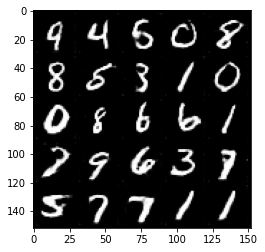

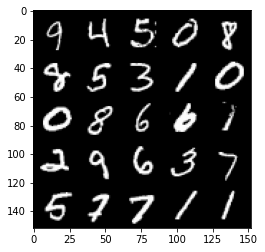

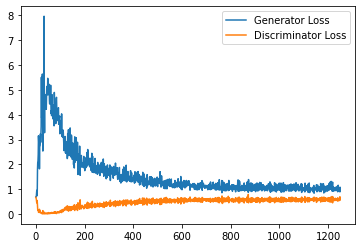

Step 25500: Generator loss: 1.0527885541915893, discriminator loss: 0.5865153639316559


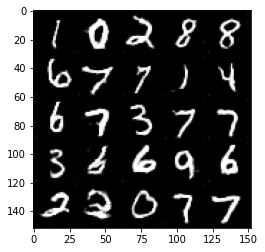

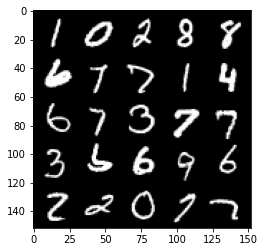

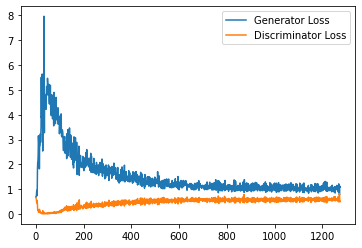

Step 26000: Generator loss: 1.0208252444267274, discriminator loss: 0.5932099950909615


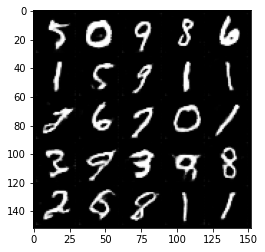

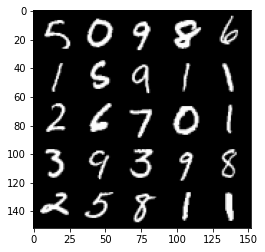

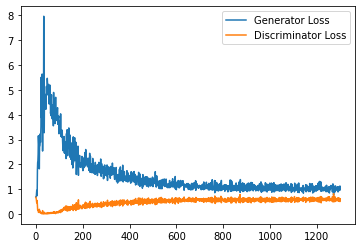

Step 26500: Generator loss: 1.0385901616811752, discriminator loss: 0.5984315090775489


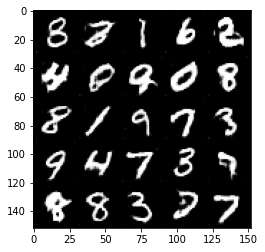

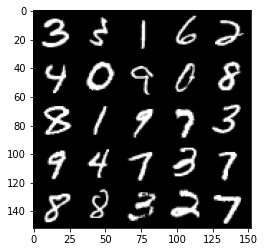

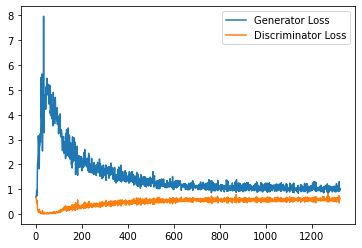

Step 27000: Generator loss: 1.023539776802063, discriminator loss: 0.5959841134548187


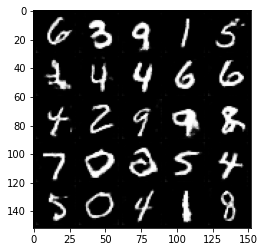

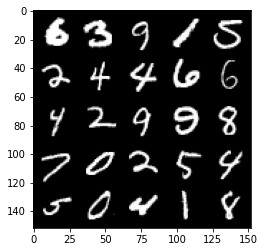

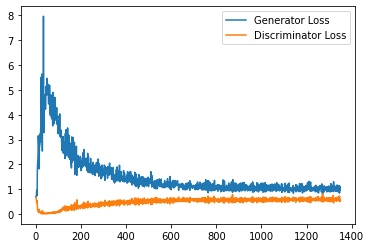

Step 27500: Generator loss: 1.0059179481267928, discriminator loss: 0.5894495581388474


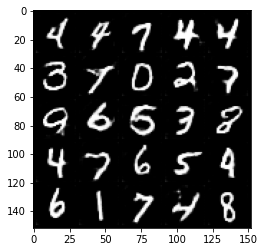

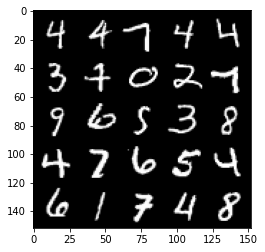

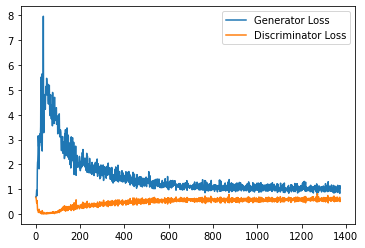

Step 28000: Generator loss: 1.0168311369419099, discriminator loss: 0.5953491079807282


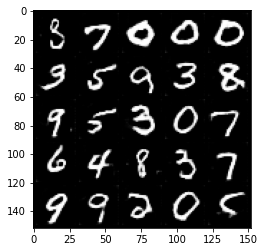

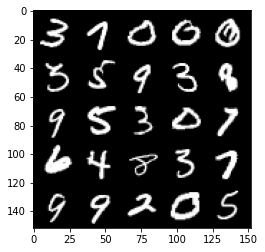

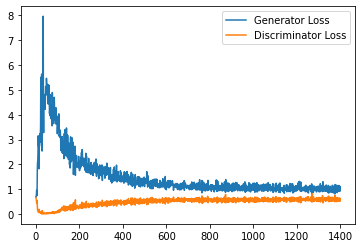

Step 28500: Generator loss: 0.9841225430965423, discriminator loss: 0.6021874912381172


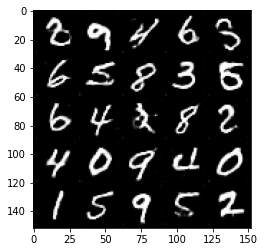

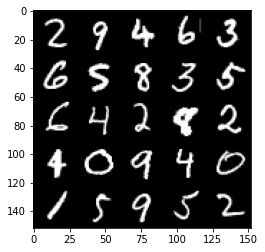

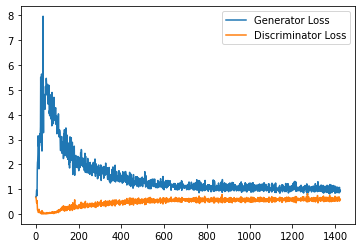

Step 29000: Generator loss: 1.0244108945131303, discriminator loss: 0.5926886312365532


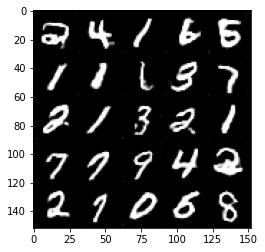

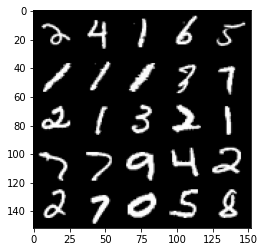

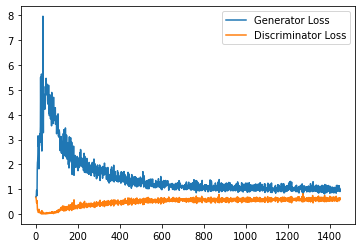

Step 29500: Generator loss: 0.9958790448904038, discriminator loss: 0.5928678504824638


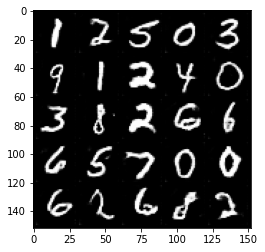

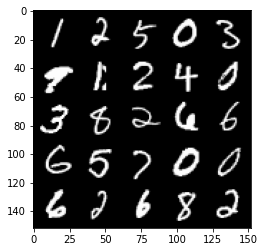

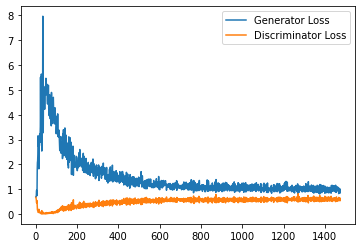

Step 30000: Generator loss: 0.9952091122865677, discriminator loss: 0.5922271464467048


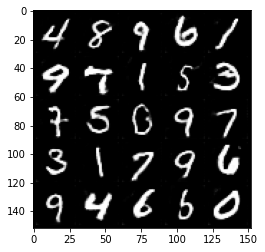

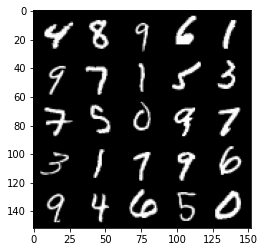

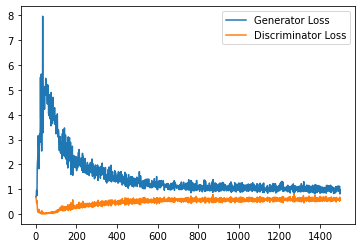

Step 30500: Generator loss: 0.9917095621824265, discriminator loss: 0.5994939537644386


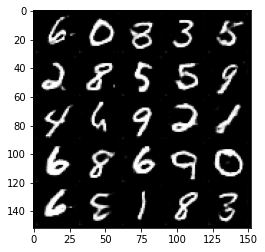

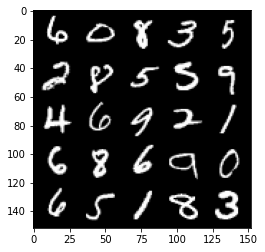

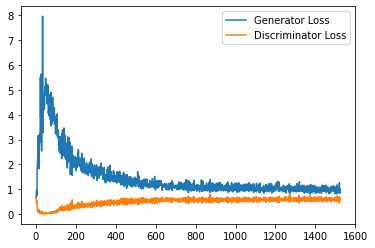

Step 31000: Generator loss: 1.020746438741684, discriminator loss: 0.5957305893898011


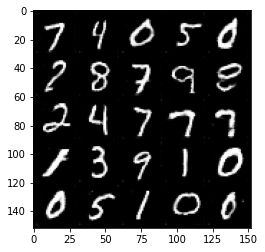

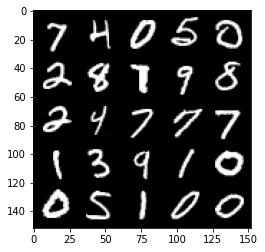

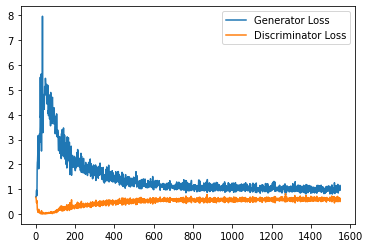

Step 31500: Generator loss: 1.0346790521144866, discriminator loss: 0.6002034128904342


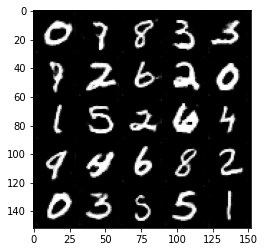

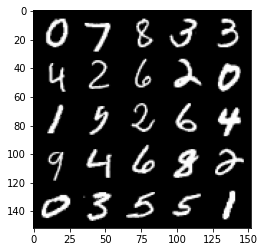

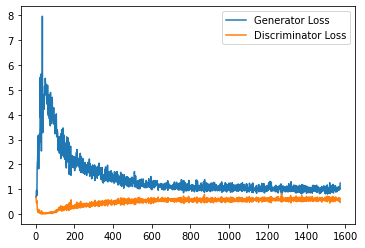

Step 32000: Generator loss: 0.9886089457273484, discriminator loss: 0.6018588381409645


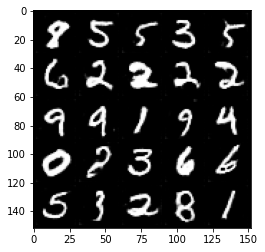

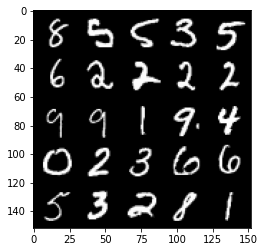

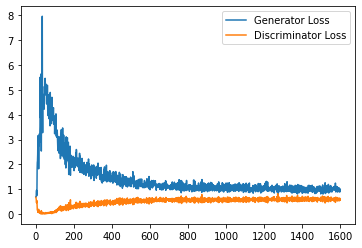

Step 32500: Generator loss: 0.9968907698392868, discriminator loss: 0.5995810938477516


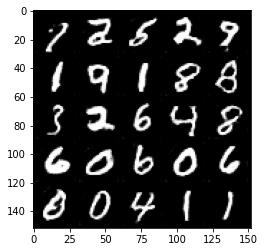

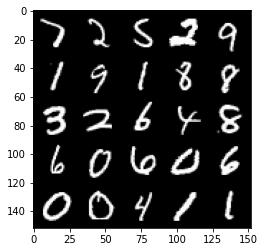

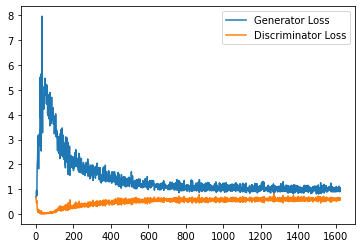

Step 33000: Generator loss: 1.0025875761508942, discriminator loss: 0.5992274763584137


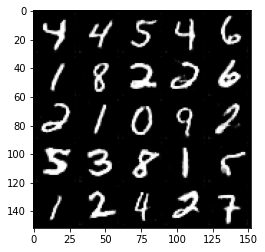

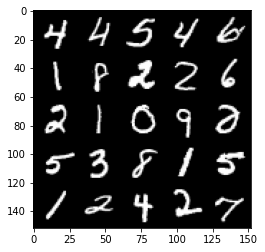

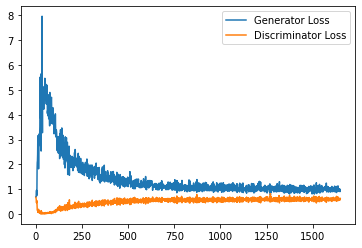

Step 33500: Generator loss: 1.0072292242050171, discriminator loss: 0.5932938658595085


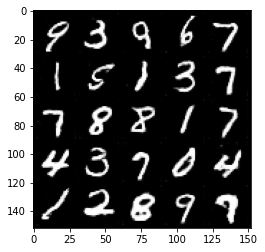

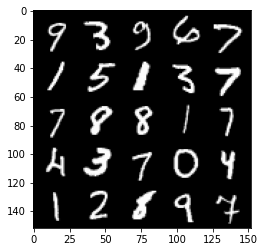

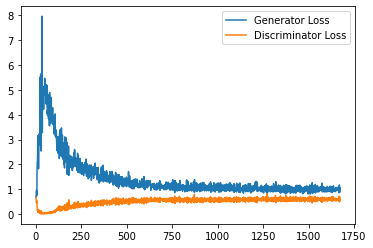

Step 34000: Generator loss: 0.971270361661911, discriminator loss: 0.6012720888257027


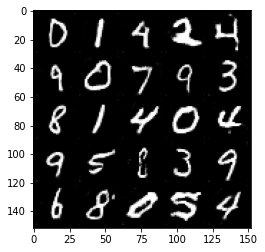

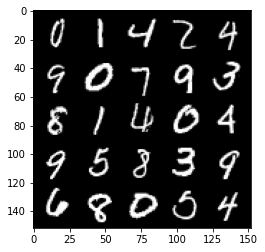

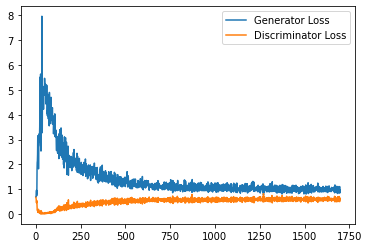

Step 34500: Generator loss: 1.0068633395433426, discriminator loss: 0.5999767723679542


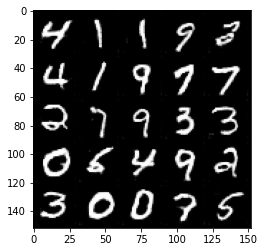

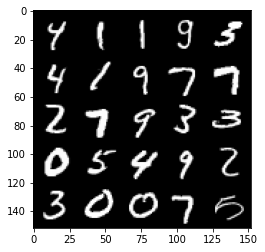

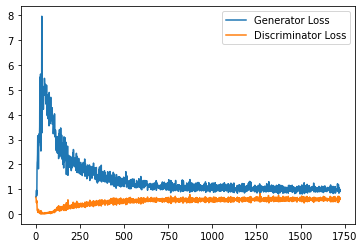

Step 35000: Generator loss: 1.003063373684883, discriminator loss: 0.5978281620740891


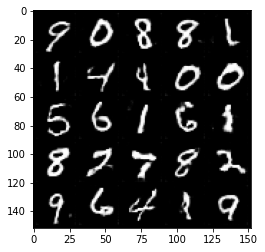

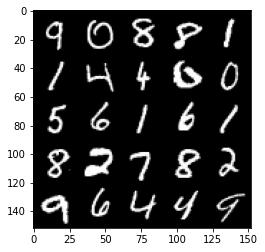

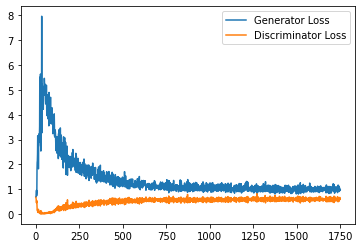

Step 35500: Generator loss: 1.0239181814193725, discriminator loss: 0.5963647555112839


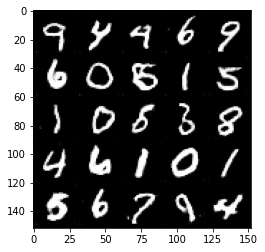

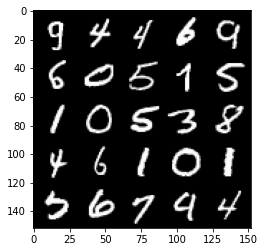

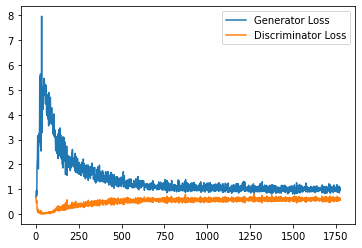

Step 36000: Generator loss: 1.0088452787399291, discriminator loss: 0.5954247083067894


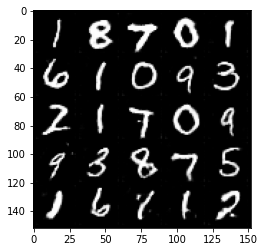

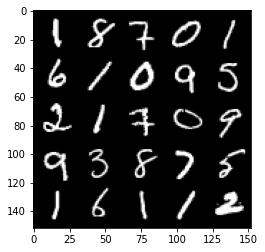

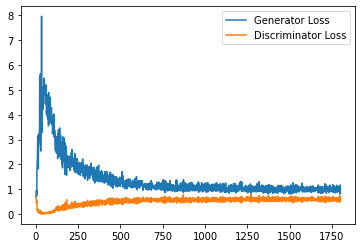

Step 36500: Generator loss: 1.0214832240343095, discriminator loss: 0.5922775124311447


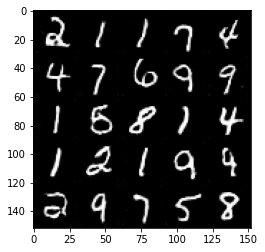

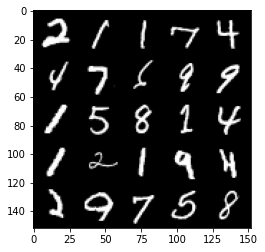

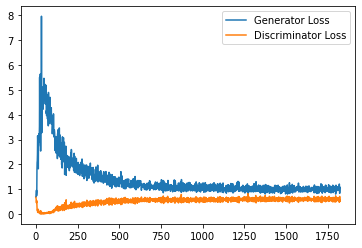

Step 37000: Generator loss: 0.9908906935453415, discriminator loss: 0.5936928352117539


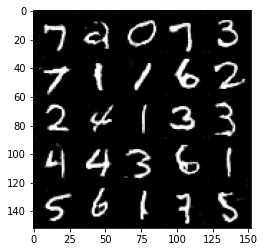

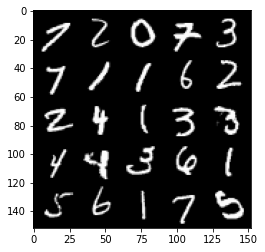

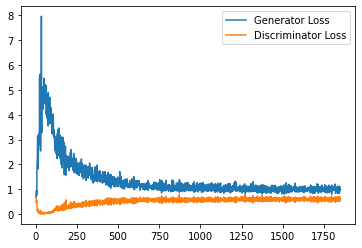

Step 37500: Generator loss: 1.023343071103096, discriminator loss: 0.5888789274096489


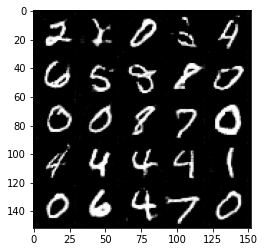

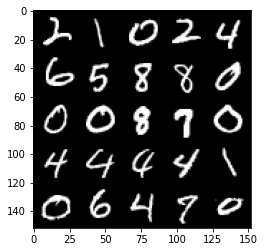

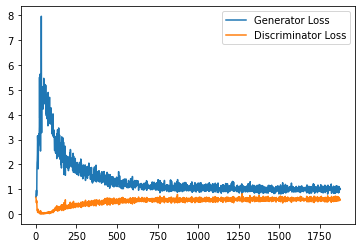

Step 38000: Generator loss: 1.0088875023126602, discriminator loss: 0.5900200330615044


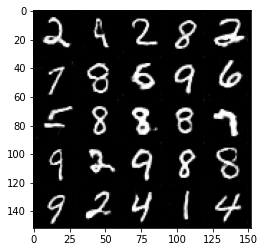

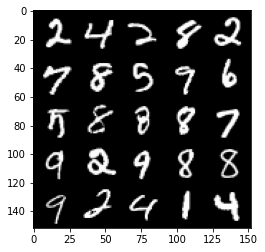

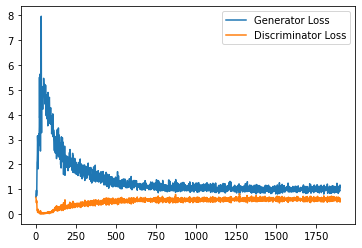

Step 38500: Generator loss: 1.0067756150960923, discriminator loss: 0.595007903277874


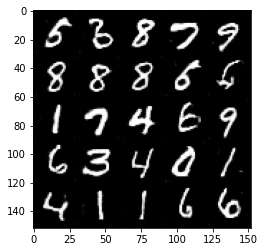

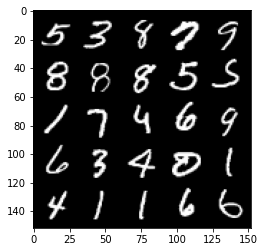

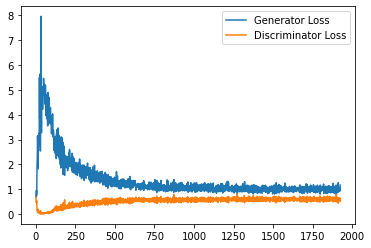

Step 39000: Generator loss: 1.0198954417705537, discriminator loss: 0.591206450164318


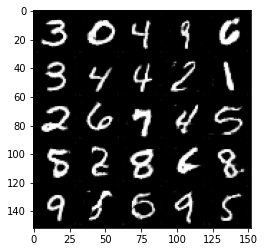

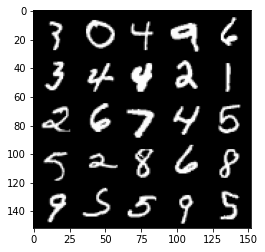

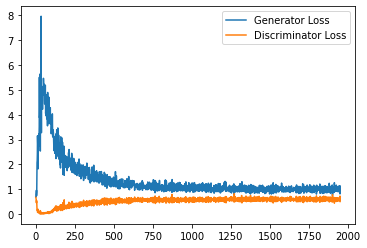

Step 39500: Generator loss: 1.0351970945596696, discriminator loss: 0.5939928582310676


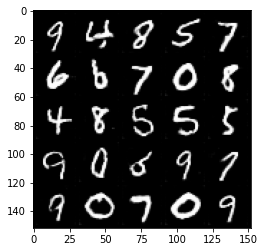

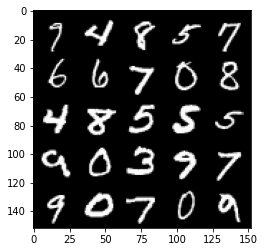

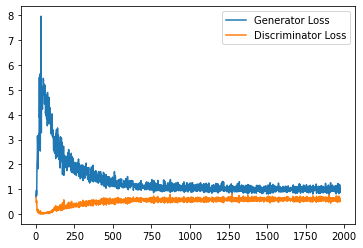

Step 40000: Generator loss: 0.9953178067207337, discriminator loss: 0.5941768881678581


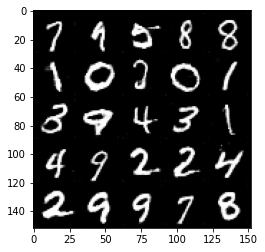

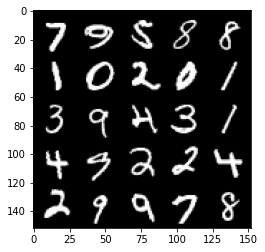

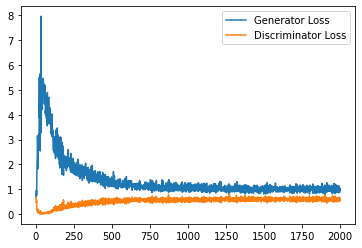

Step 40500: Generator loss: 1.0063762279748916, discriminator loss: 0.5929359630942345


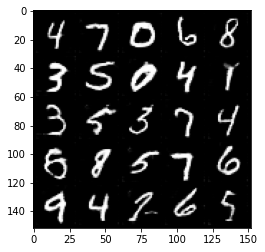

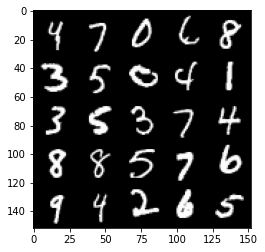

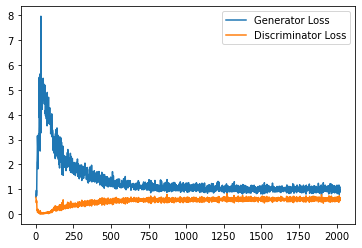

Step 41000: Generator loss: 1.02113034760952, discriminator loss: 0.5860312418341637


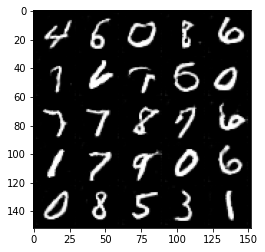

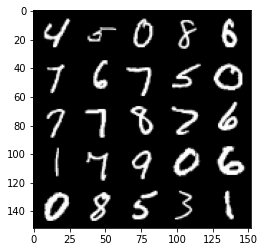

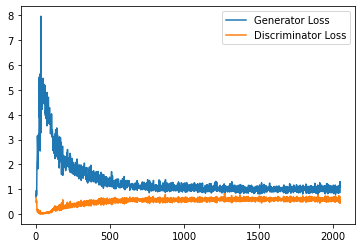

Step 41500: Generator loss: 1.025810849905014, discriminator loss: 0.5869388940930367


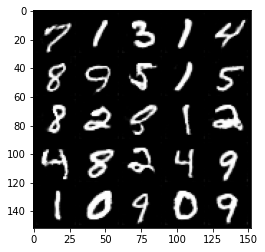

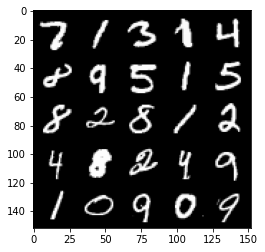

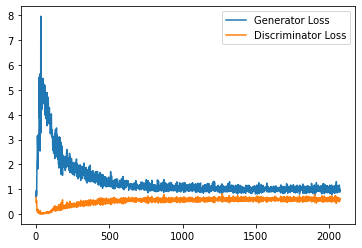

Step 42000: Generator loss: 0.9957520773410797, discriminator loss: 0.5842441601157189


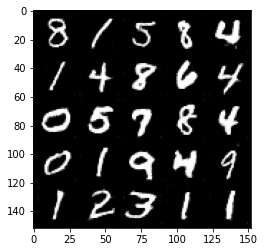

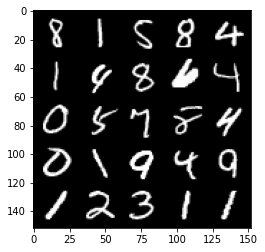

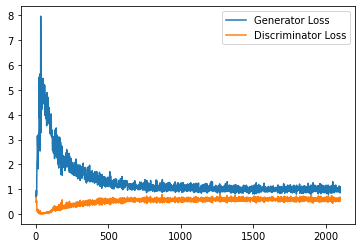

Step 42500: Generator loss: 1.0321959168910981, discriminator loss: 0.5877401824593544


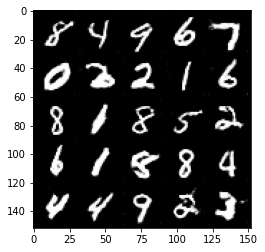

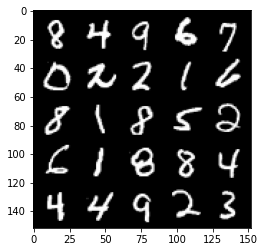

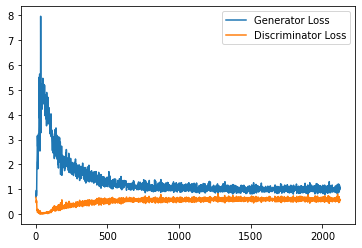

Step 43000: Generator loss: 1.0224450517892838, discriminator loss: 0.5900836515426636


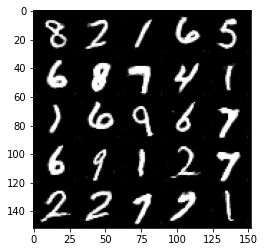

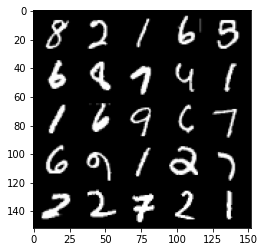

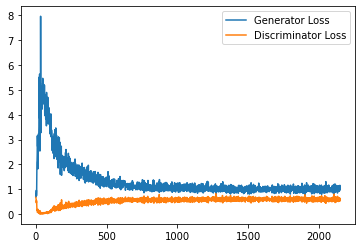

Step 43500: Generator loss: 1.0244259395599364, discriminator loss: 0.5831429218053817


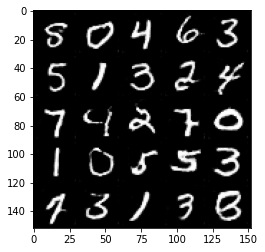

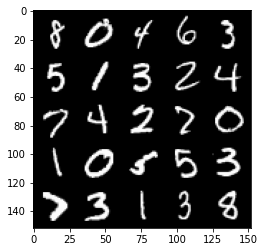

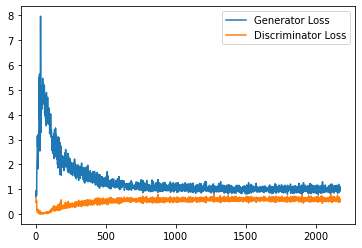

Step 44000: Generator loss: 1.0122621577978135, discriminator loss: 0.5820406187772751


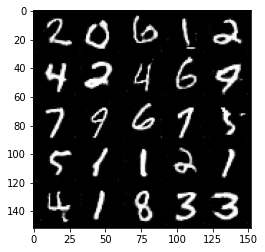

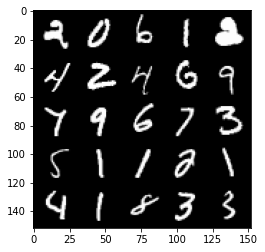

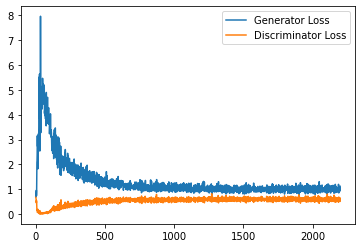

Step 44500: Generator loss: 1.016808514237404, discriminator loss: 0.5891577507257462


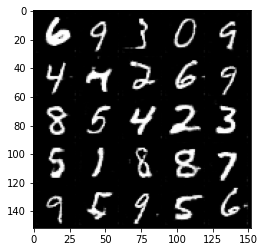

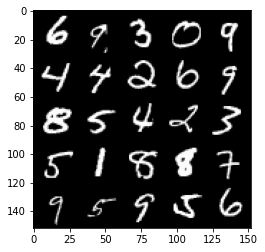

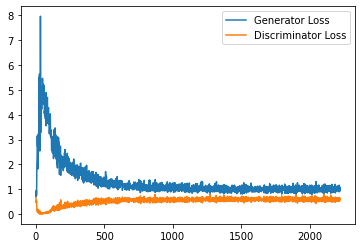

Step 45000: Generator loss: 1.0214130049943924, discriminator loss: 0.5812895932793617


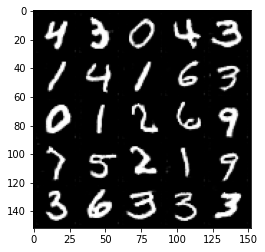

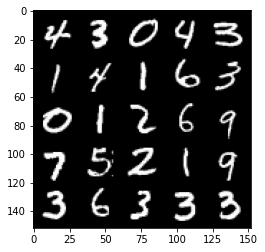

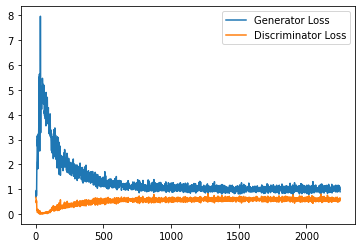

Step 45500: Generator loss: 1.035287258028984, discriminator loss: 0.5797452052235603


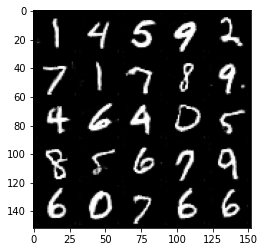

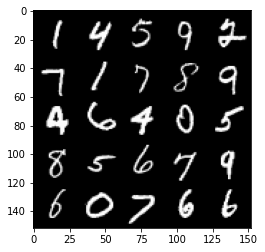

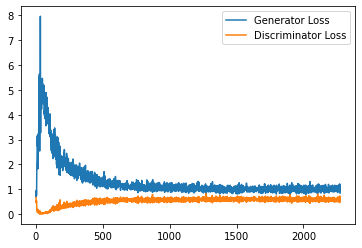

Step 46000: Generator loss: 1.0256616793870925, discriminator loss: 0.5744165299534798


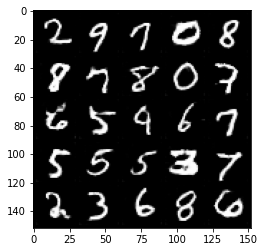

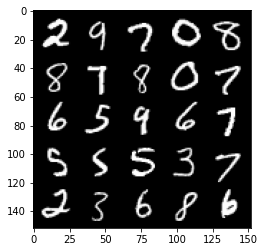

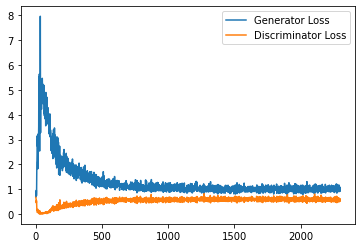

Step 46500: Generator loss: 1.0326087423563004, discriminator loss: 0.5766624398231507


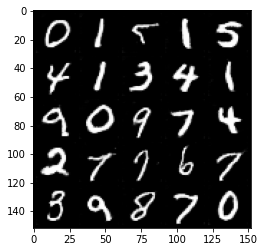

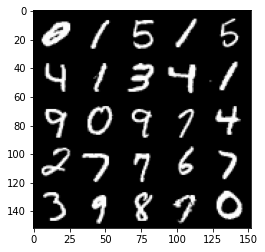

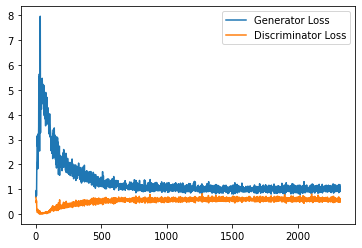

Step 47000: Generator loss: 1.0564630097150802, discriminator loss: 0.5764416646957398


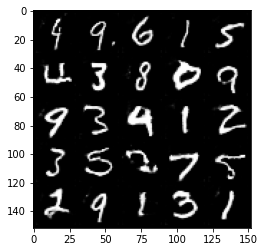

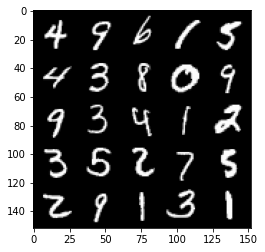

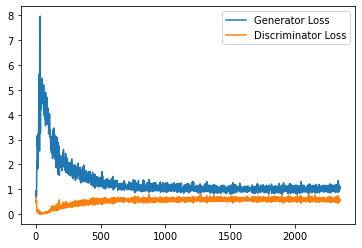

Step 47500: Generator loss: 1.0336857031583786, discriminator loss: 0.57917292958498


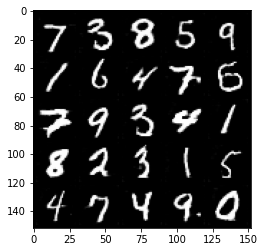

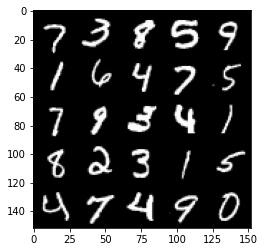

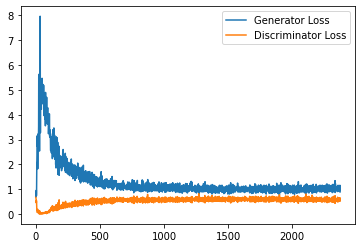

Step 48000: Generator loss: 1.048741261959076, discriminator loss: 0.5740816256403923


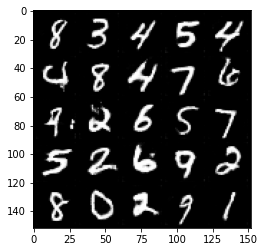

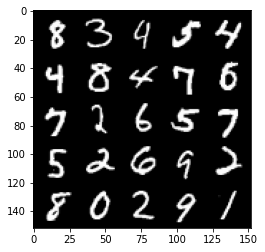

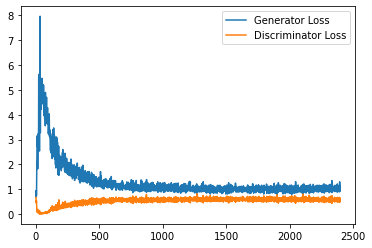

Step 48500: Generator loss: 1.0354129519462585, discriminator loss: 0.5746023274064064


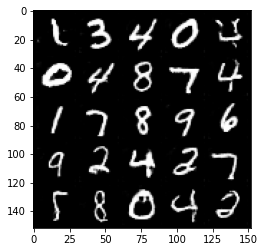

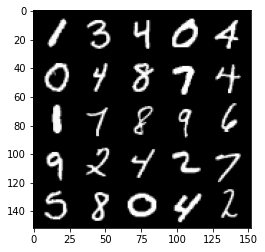

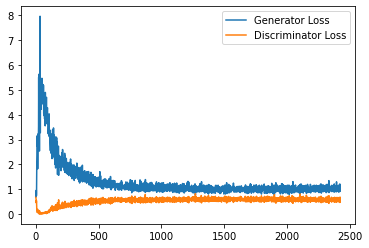

Step 49000: Generator loss: 1.03549360537529, discriminator loss: 0.5726481689810753


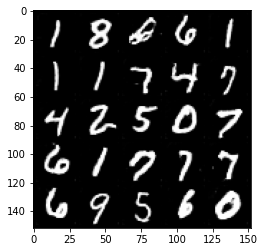

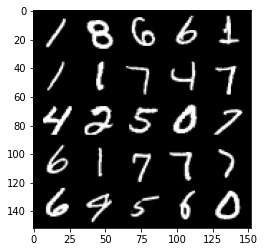

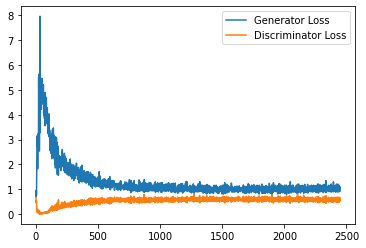

Step 49500: Generator loss: 1.0398083109855651, discriminator loss: 0.5733892086148262


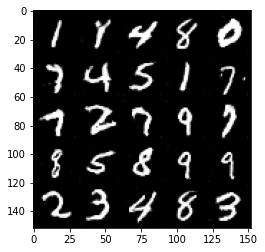

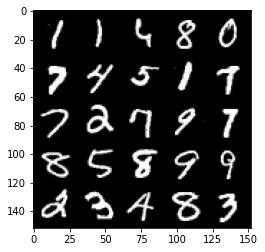

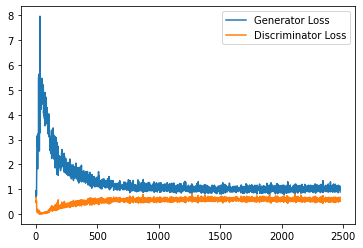

Step 50000: Generator loss: 1.0673073499202728, discriminator loss: 0.5641681488752365


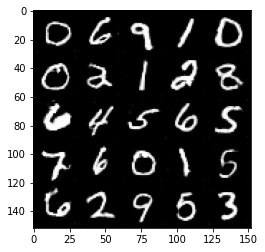

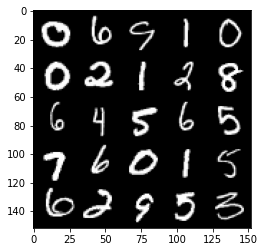

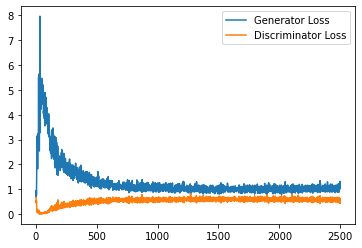

Step 50500: Generator loss: 1.0518932104110719, discriminator loss: 0.5708032060861588


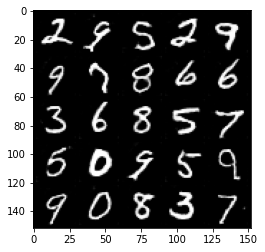

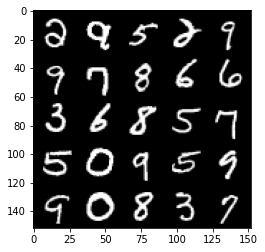

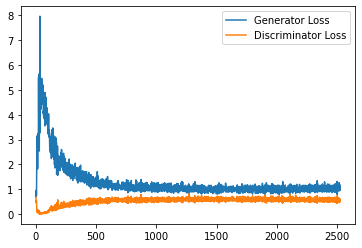

Step 51000: Generator loss: 1.058963998436928, discriminator loss: 0.5663796648979187


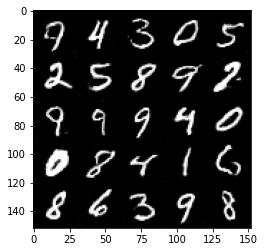

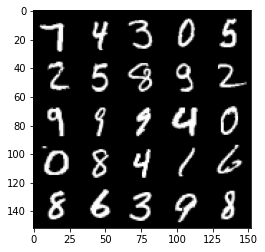

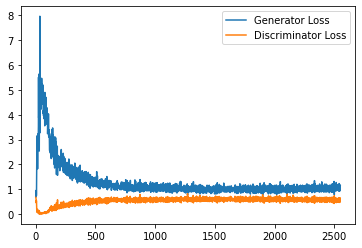

Step 51500: Generator loss: 1.0374285879135132, discriminator loss: 0.5665924708843231


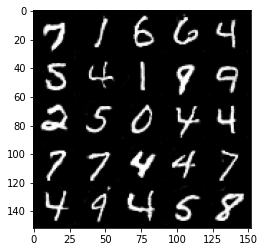

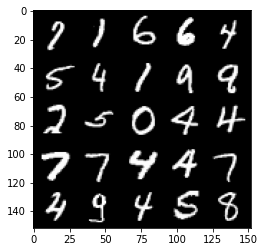

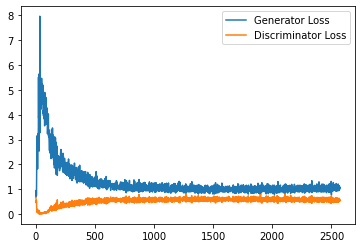

Step 52000: Generator loss: 1.067790942311287, discriminator loss: 0.5685513471961021


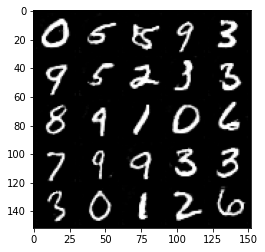

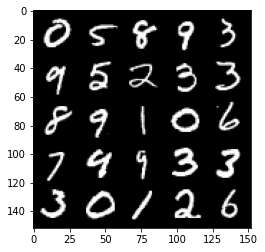

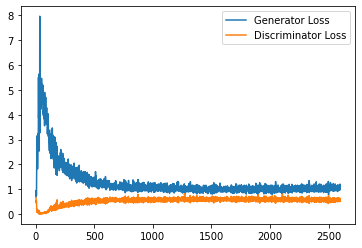

Step 52500: Generator loss: 1.0586546026468278, discriminator loss: 0.5655559147000313


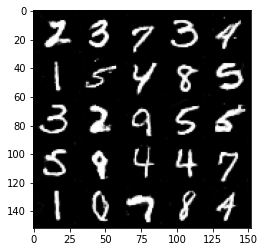

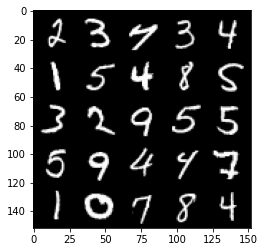

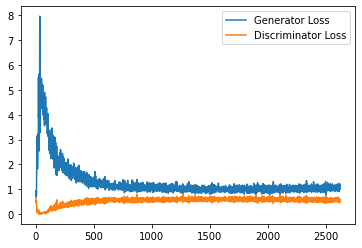

Step 53000: Generator loss: 1.066698832154274, discriminator loss: 0.5689138287305832


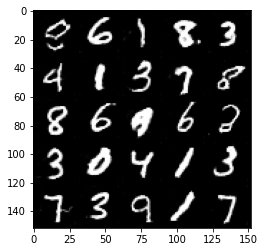

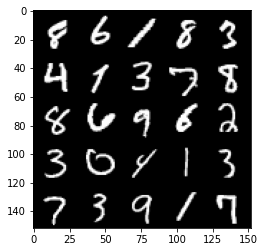

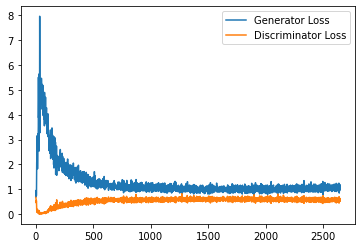

Step 53500: Generator loss: 1.0588679537773131, discriminator loss: 0.5672795348763466


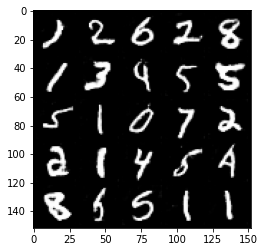

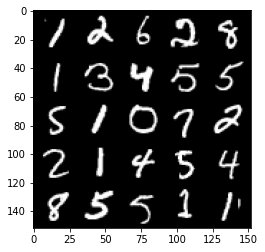

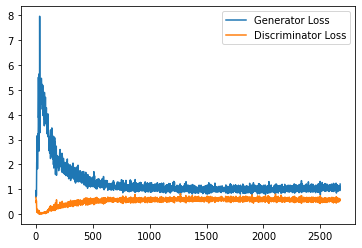

Step 54000: Generator loss: 1.038786718249321, discriminator loss: 0.5634894750118256


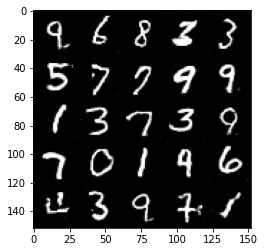

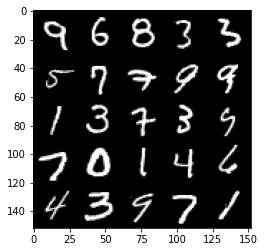

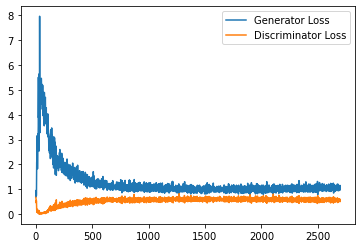

Step 54500: Generator loss: 1.0708875426054, discriminator loss: 0.5655734831690788


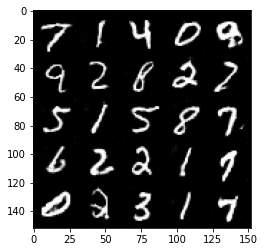

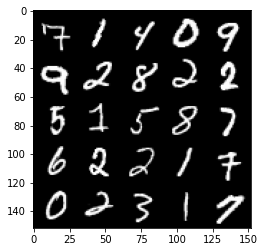

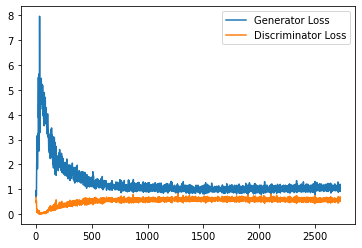

Step 55000: Generator loss: 1.0846497910022737, discriminator loss: 0.5601645988821984


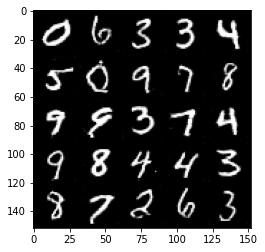

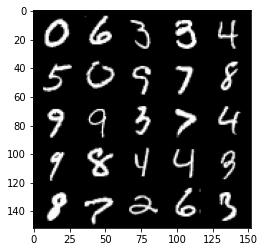

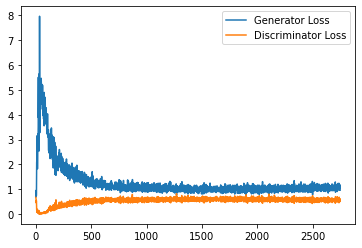

Step 55500: Generator loss: 1.0808120691776275, discriminator loss: 0.5624881274104119


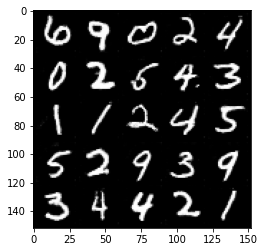

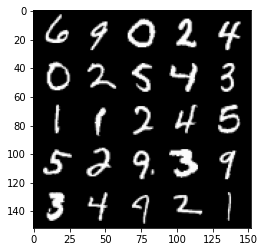

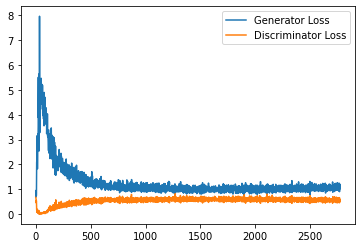

Step 56000: Generator loss: 1.072355358839035, discriminator loss: 0.5603851202726364


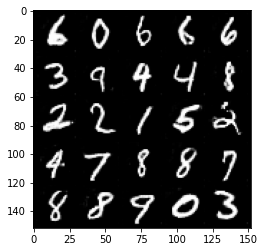

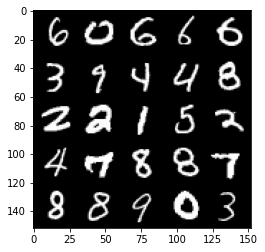

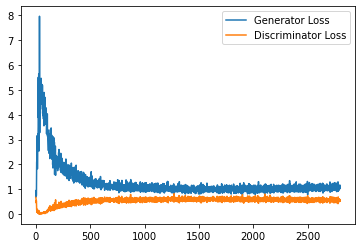

Step 56500: Generator loss: 1.0588870441913605, discriminator loss: 0.5596055352687835


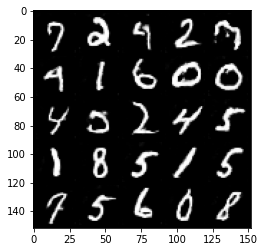

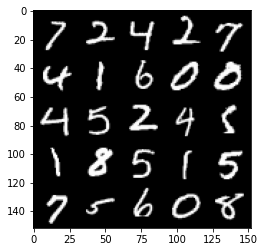

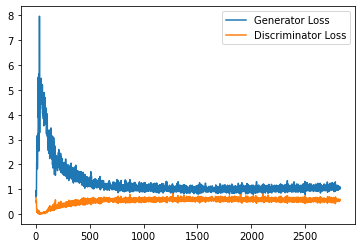

Step 57000: Generator loss: 1.0759108581542969, discriminator loss: 0.5612714475393296


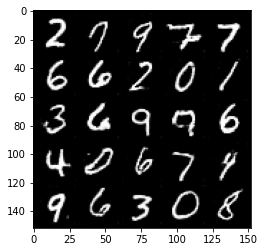

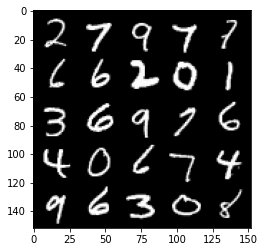

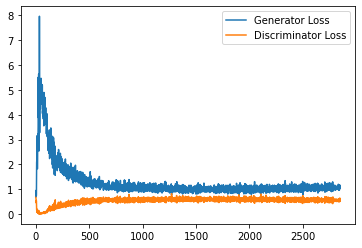

Step 57500: Generator loss: 1.0873263775110245, discriminator loss: 0.5583934250473976


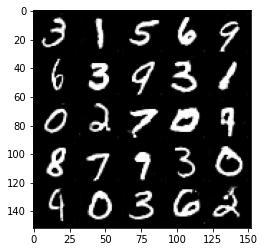

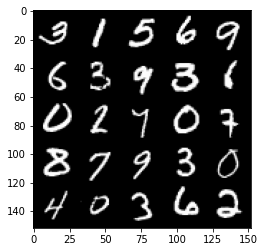

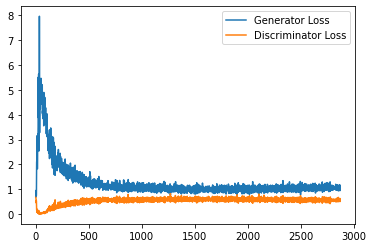

Step 58000: Generator loss: 1.103079586625099, discriminator loss: 0.5639378362298012


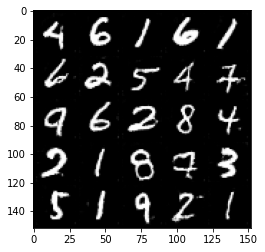

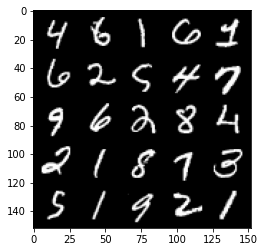

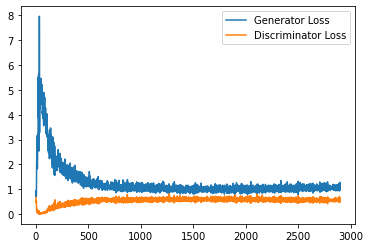

Step 58500: Generator loss: 1.1176201122999192, discriminator loss: 0.5495209397077561


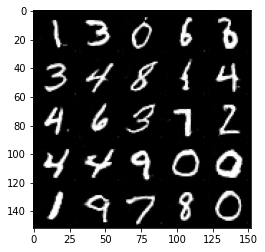

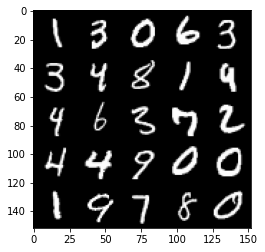

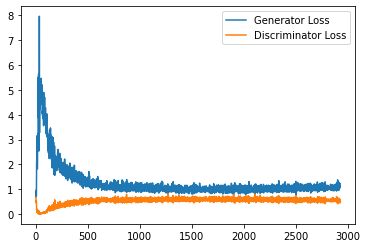

Step 59000: Generator loss: 1.0724766758680344, discriminator loss: 0.5595522276759147


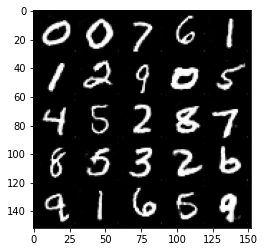

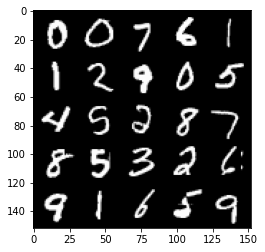

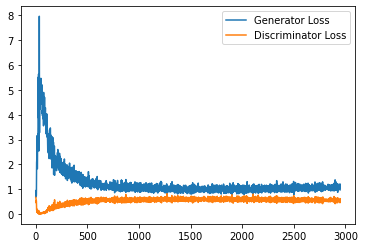

Step 59500: Generator loss: 1.0958993844985963, discriminator loss: 0.5556293104290962


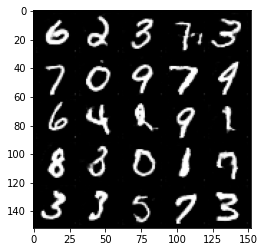

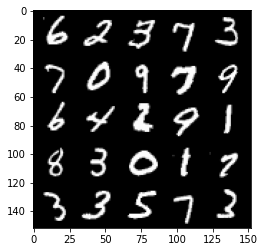

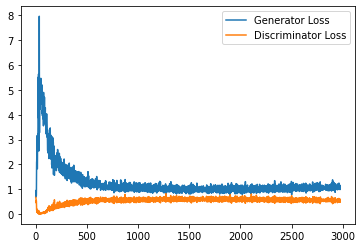

Step 60000: Generator loss: 1.091519713640213, discriminator loss: 0.5595080081820488


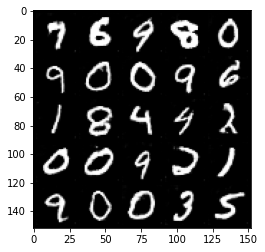

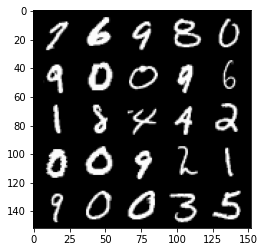

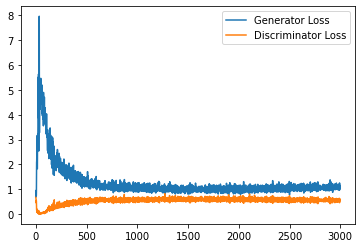

Step 60500: Generator loss: 1.0960371888875962, discriminator loss: 0.5599857470989227


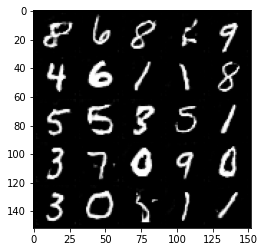

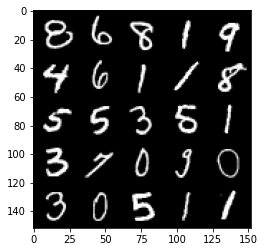

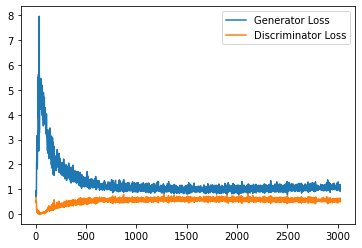

Step 61000: Generator loss: 1.1085813561677933, discriminator loss: 0.5505785053968429


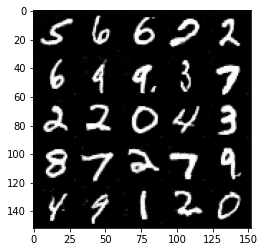

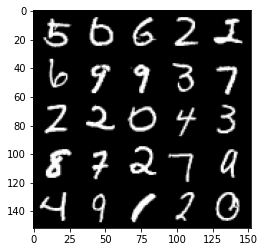

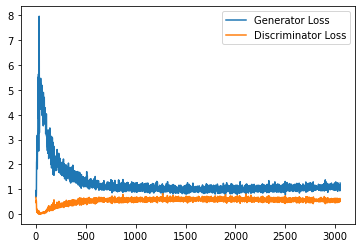

Step 61500: Generator loss: 1.1033199477195739, discriminator loss: 0.5566183716058731


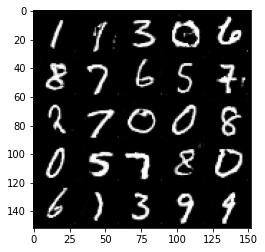

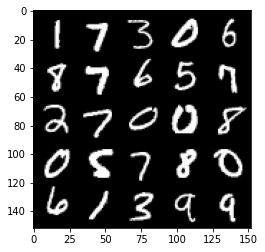

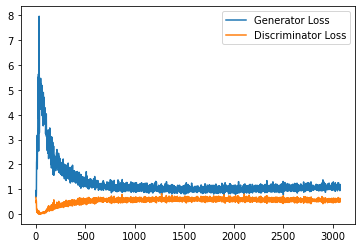

Step 62000: Generator loss: 1.0855279508829117, discriminator loss: 0.5612578237652779


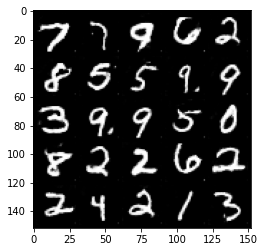

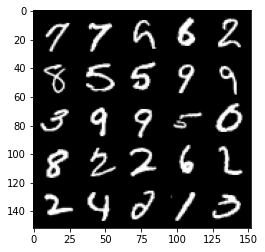

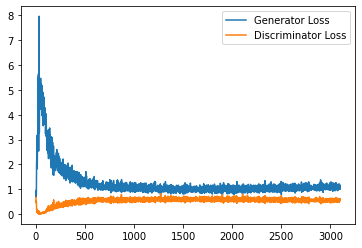

Step 62500: Generator loss: 1.1055541493892669, discriminator loss: 0.5523806820511818


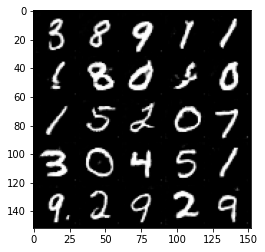

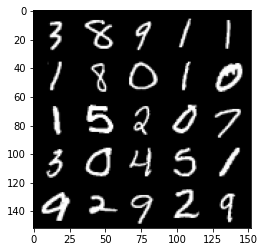

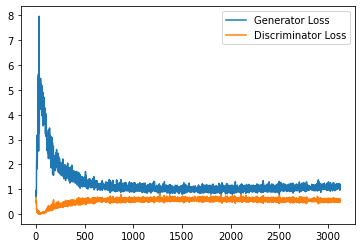

Step 63000: Generator loss: 1.1101263884305954, discriminator loss: 0.5536066053509712


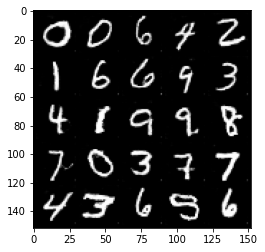

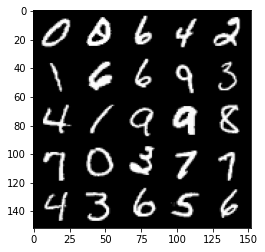

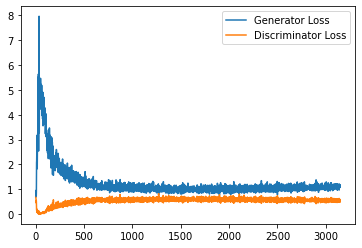

Step 63500: Generator loss: 1.1040233541727067, discriminator loss: 0.553520460665226


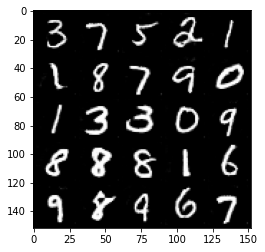

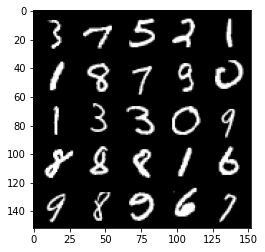

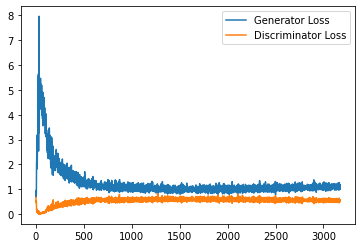

Step 64000: Generator loss: 1.0929911208152772, discriminator loss: 0.5584279888868332


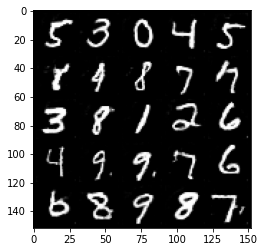

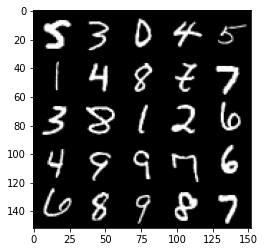

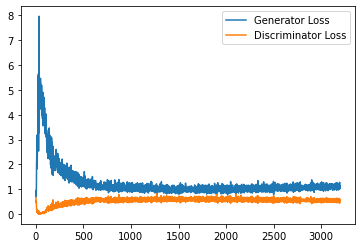

Step 64500: Generator loss: 1.107446541428566, discriminator loss: 0.5515578191876411


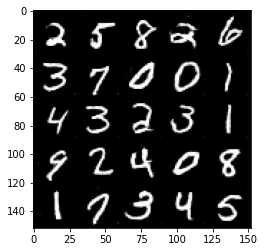

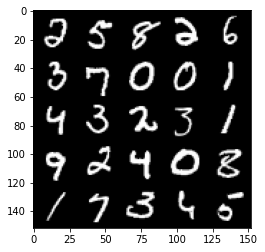

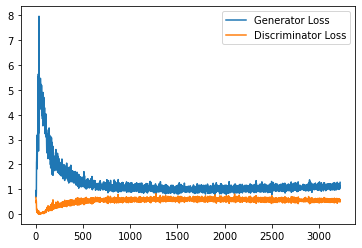

Step 65000: Generator loss: 1.083244943857193, discriminator loss: 0.5592516137361526


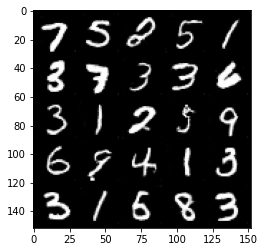

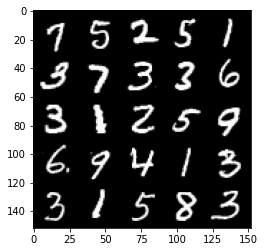

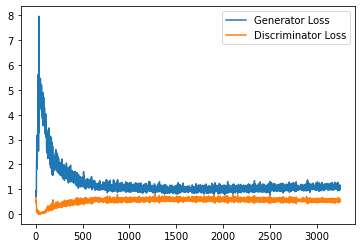

Step 65500: Generator loss: 1.0942707114219665, discriminator loss: 0.5591339600682259


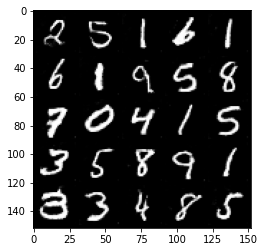

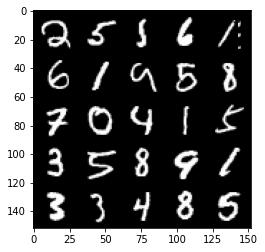

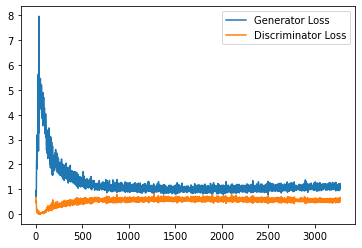

Step 66000: Generator loss: 1.102037533044815, discriminator loss: 0.5612401887774467


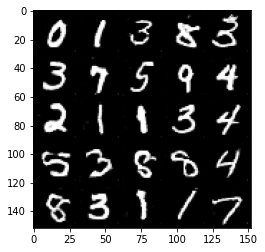

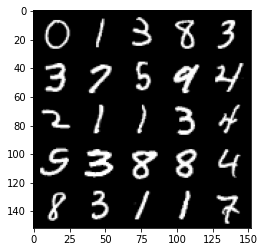

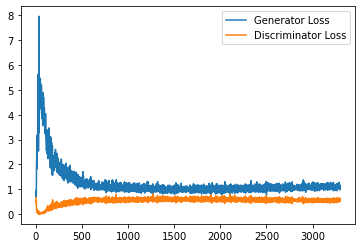

Step 66500: Generator loss: 1.105344366312027, discriminator loss: 0.5650903761386872


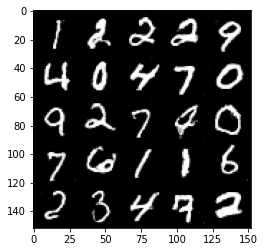

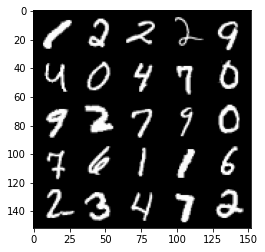

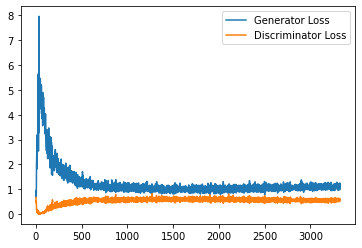

Step 67000: Generator loss: 1.11636632168293, discriminator loss: 0.5534340806603432


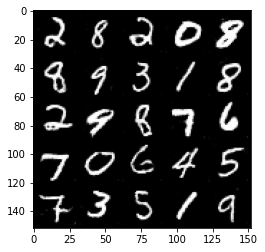

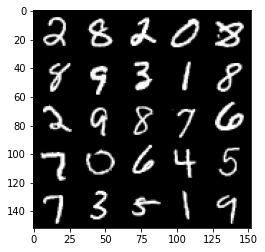

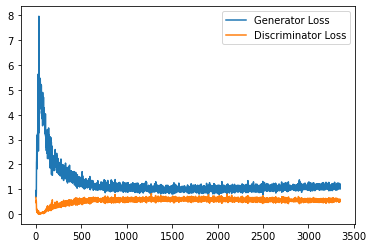

Step 67500: Generator loss: 1.1159010744094848, discriminator loss: 0.5615113299489022


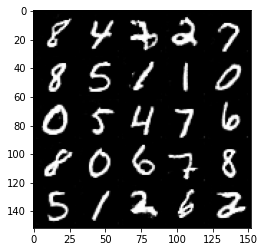

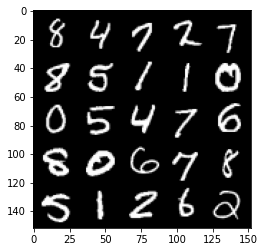

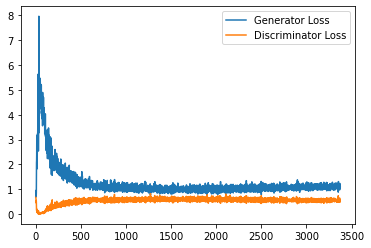

Step 68000: Generator loss: 1.1081891496181488, discriminator loss: 0.5578396106362343


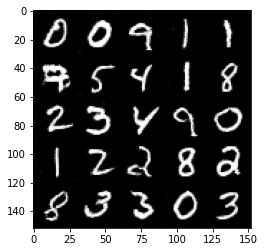

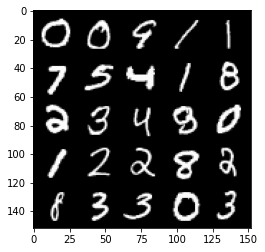

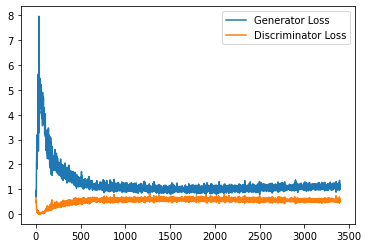

Step 68500: Generator loss: 1.1075395456552506, discriminator loss: 0.5577240853309632


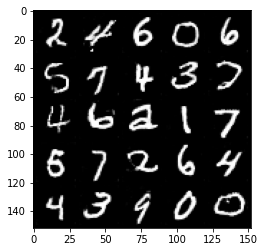

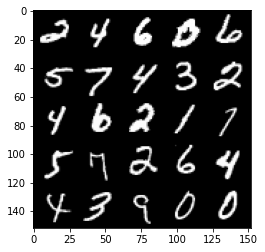

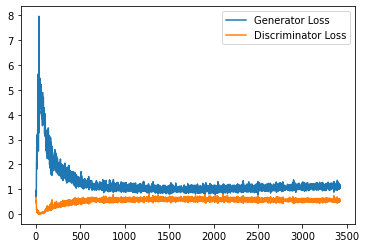

Step 69000: Generator loss: 1.119988863825798, discriminator loss: 0.5529415647983551


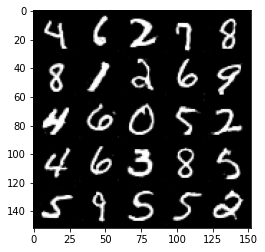

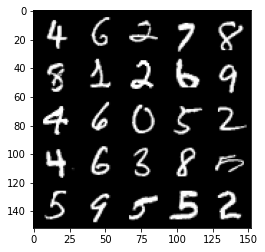

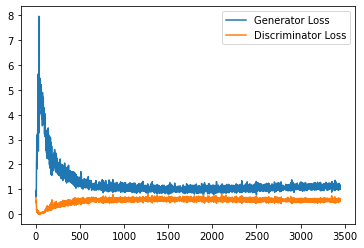

Step 69500: Generator loss: 1.0837868155241013, discriminator loss: 0.5567211845517158


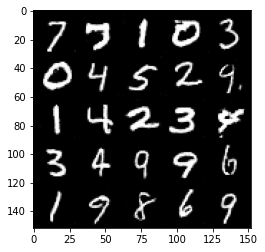

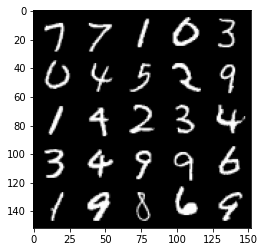

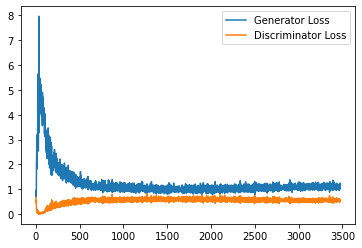

Step 70000: Generator loss: 1.119417617917061, discriminator loss: 0.5638144755959511


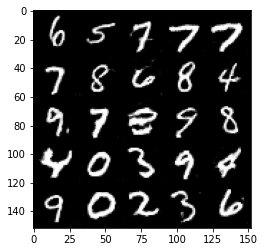

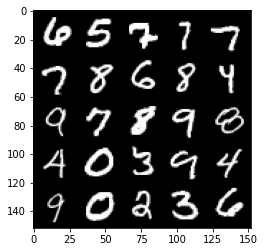

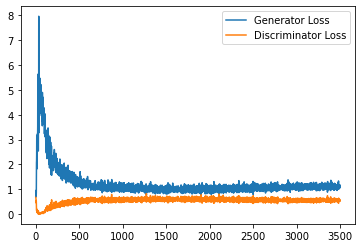

Step 70500: Generator loss: 1.0890932878255843, discriminator loss: 0.5598905705213547


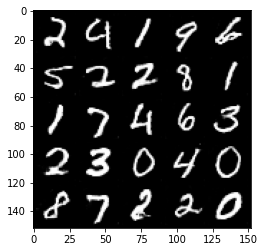

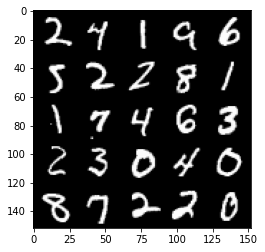

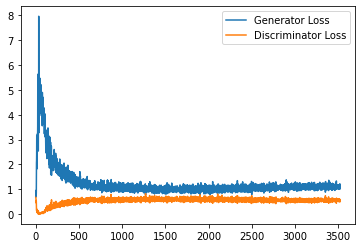

Step 71000: Generator loss: 1.121633572936058, discriminator loss: 0.5579107529520988


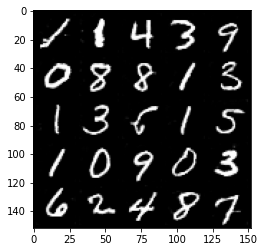

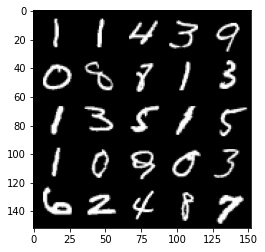

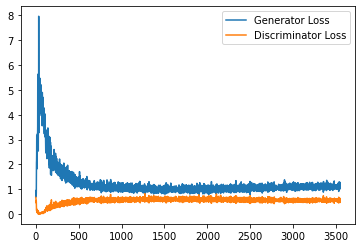

Step 71500: Generator loss: 1.0812651168107987, discriminator loss: 0.5617508472204208


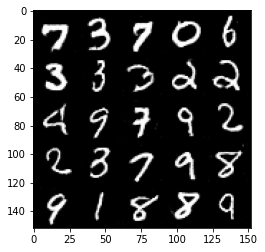

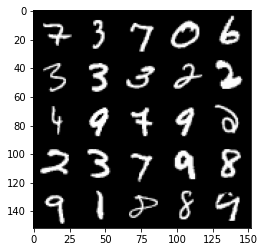

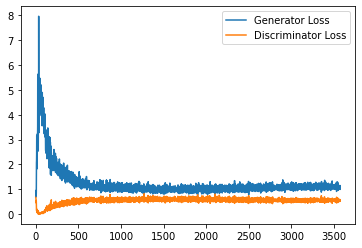

Step 72000: Generator loss: 1.1022751808166504, discriminator loss: 0.560183897793293


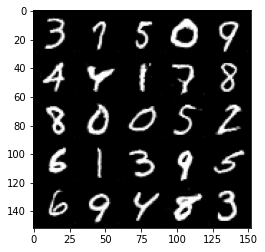

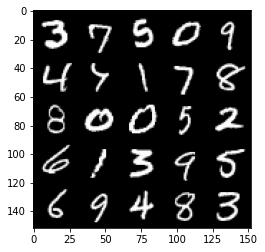

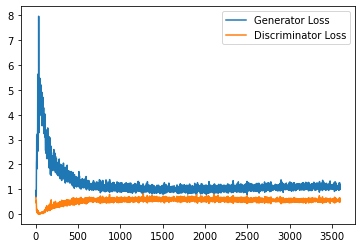

Step 72500: Generator loss: 1.125279553771019, discriminator loss: 0.5601331948637962


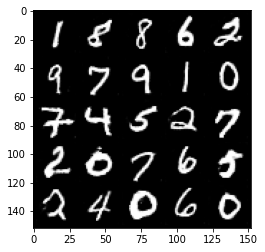

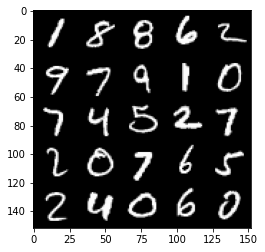

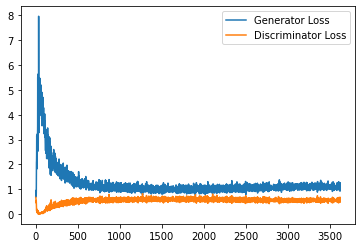

Step 73000: Generator loss: 1.1159437433481216, discriminator loss: 0.5619775181412697


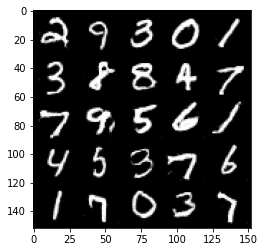

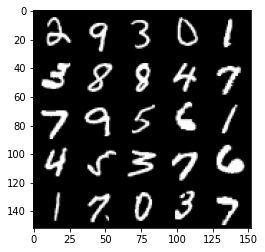

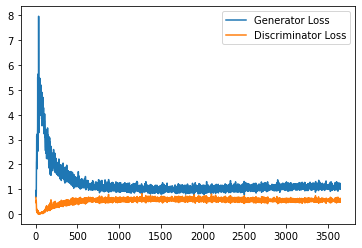

Step 73500: Generator loss: 1.0902506388425828, discriminator loss: 0.5597036525011062


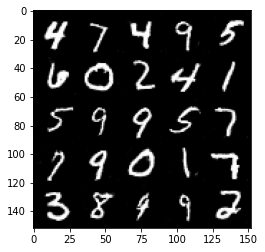

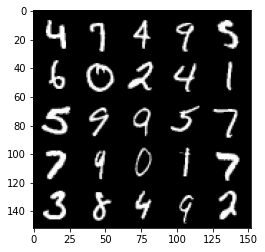

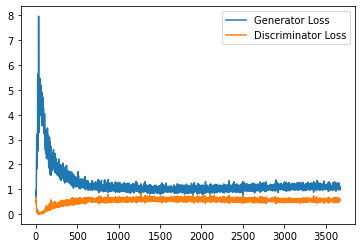

Step 74000: Generator loss: 1.0898309355974198, discriminator loss: 0.5663725363612175


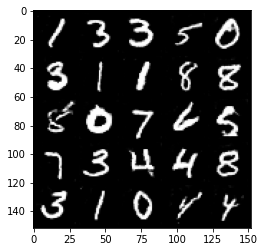

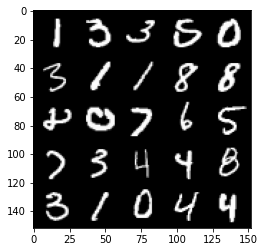

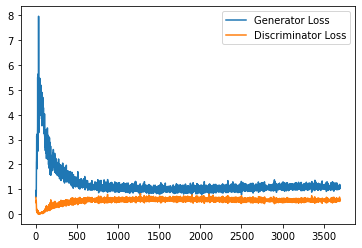

Step 74500: Generator loss: 1.1008122949600219, discriminator loss: 0.5568236827254295


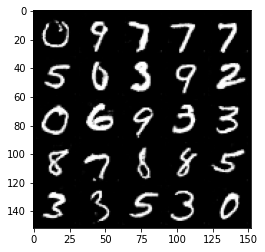

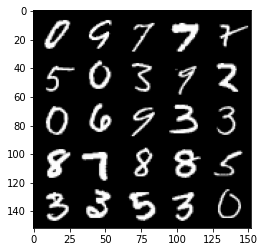

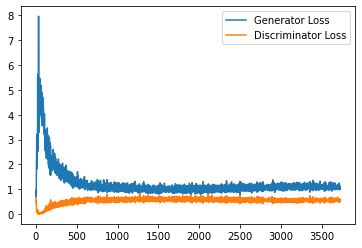

Step 75000: Generator loss: 1.0991585631370544, discriminator loss: 0.5597313653230667


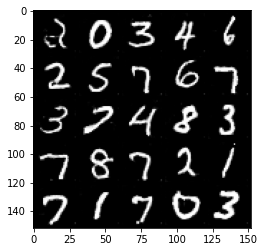

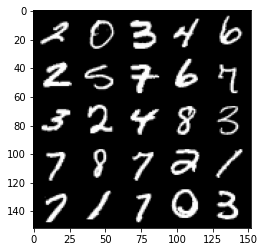

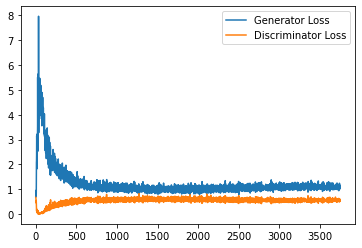

Step 75500: Generator loss: 1.1124407262802125, discriminator loss: 0.5670110898613929


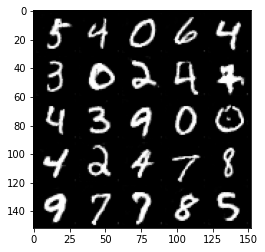

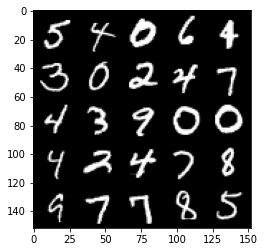

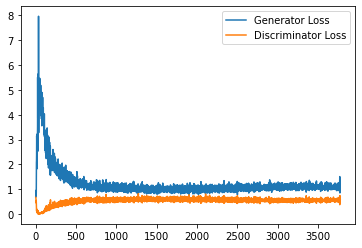

Step 76000: Generator loss: 1.122325074672699, discriminator loss: 0.5600773159265519


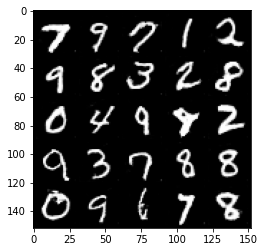

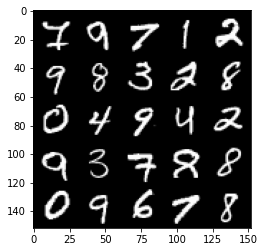

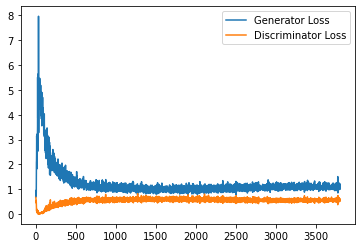

Step 76500: Generator loss: 1.0909122104644775, discriminator loss: 0.5620280277132989


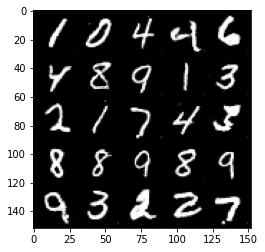

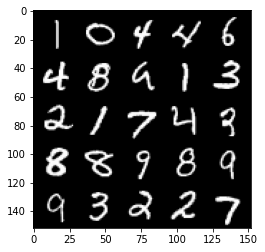

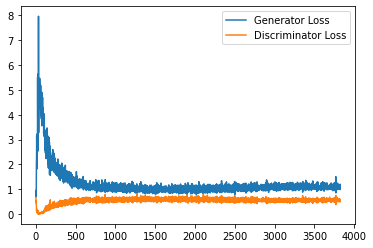

Step 77000: Generator loss: 1.0897355778217315, discriminator loss: 0.5644768485426903


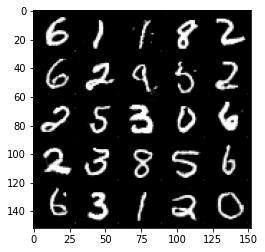

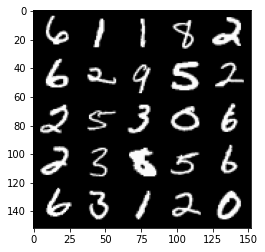

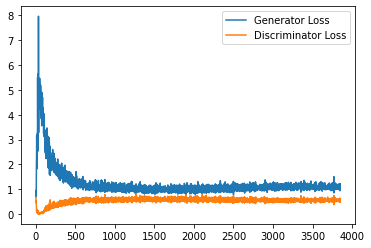

Step 77500: Generator loss: 1.1196525769233703, discriminator loss: 0.5674781167507171


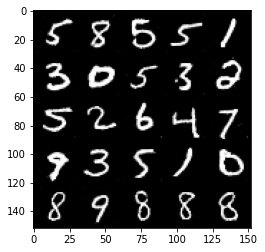

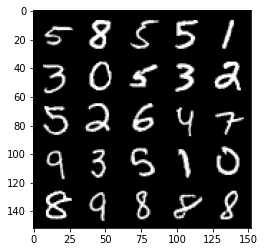

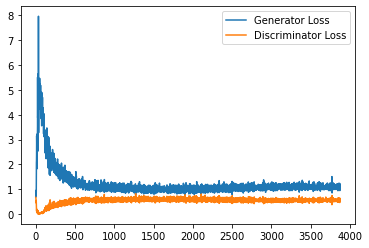

Step 78000: Generator loss: 1.0869087067842484, discriminator loss: 0.5611988038420678


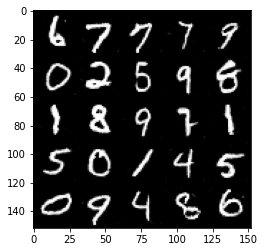

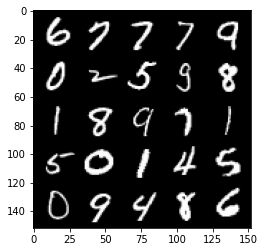

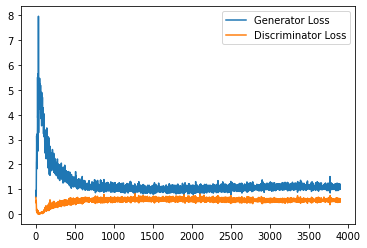

Step 78500: Generator loss: 1.1092900480031966, discriminator loss: 0.5628565899133682


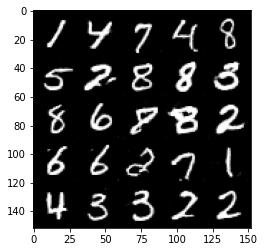

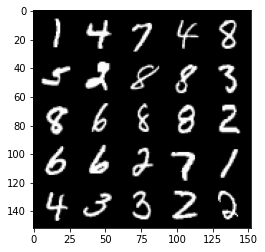

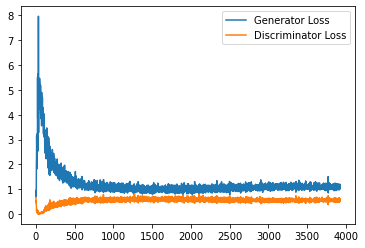

Step 79000: Generator loss: 1.0984196382761002, discriminator loss: 0.5668372784852982


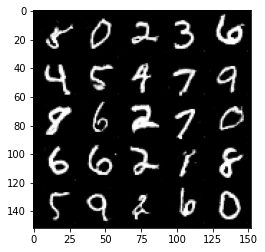

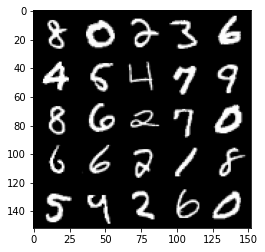

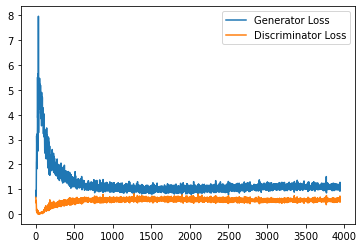

Step 79500: Generator loss: 1.0932417925596236, discriminator loss: 0.5625917006134987


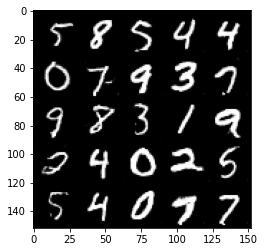

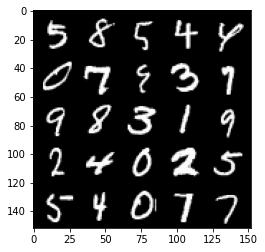

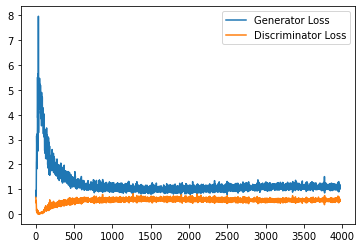

Step 80000: Generator loss: 1.0955072096586227, discriminator loss: 0.5646507833003998


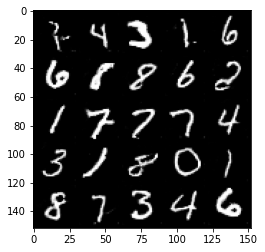

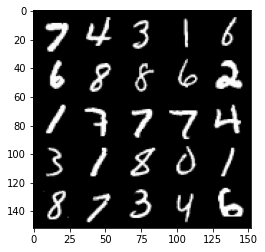

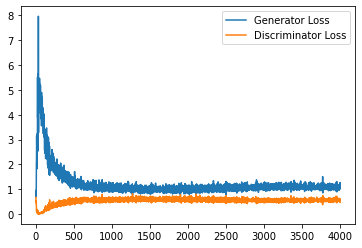

Step 80500: Generator loss: 1.0918382177352906, discriminator loss: 0.5711329116225242


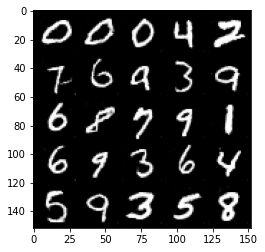

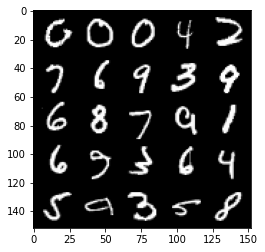

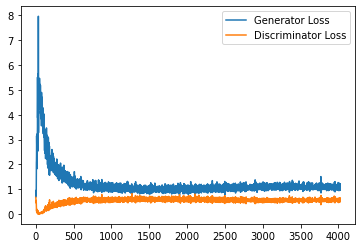

Step 81000: Generator loss: 1.1282605749368668, discriminator loss: 0.5631281054019928


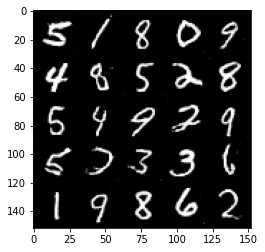

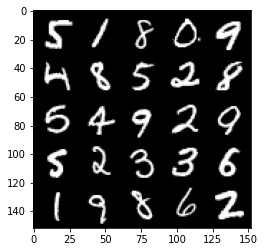

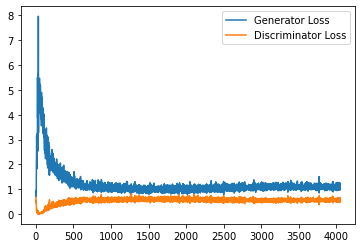

Step 81500: Generator loss: 1.0786601959466935, discriminator loss: 0.5720020813941955


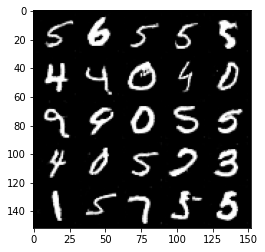

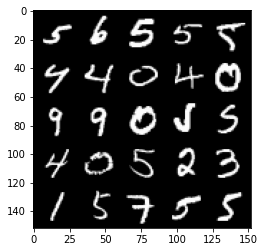

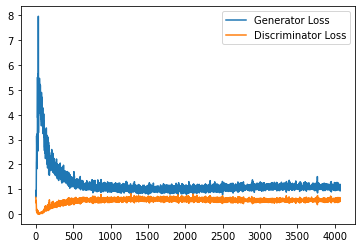

Step 82000: Generator loss: 1.1136745512485504, discriminator loss: 0.5635780797600746


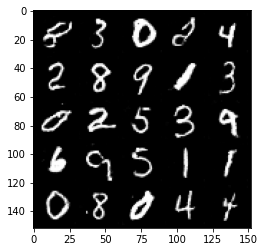

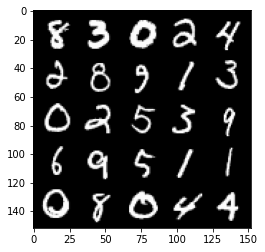

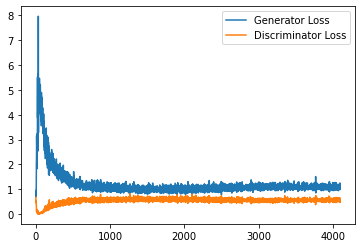

Step 82500: Generator loss: 1.105964350104332, discriminator loss: 0.5661499431729317


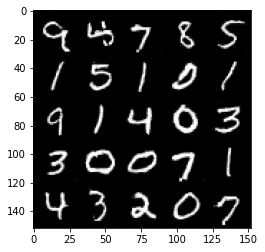

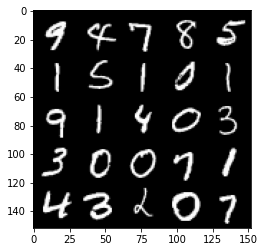

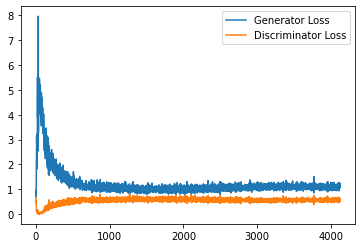

Step 83000: Generator loss: 1.0903355664014815, discriminator loss: 0.5717266434431076


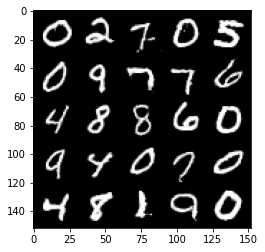

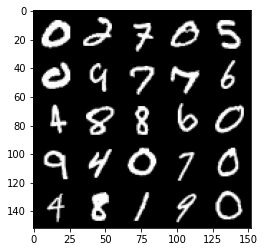

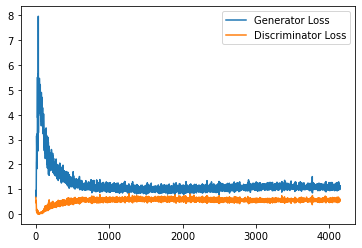

Step 83500: Generator loss: 1.083370661020279, discriminator loss: 0.5668133241534233


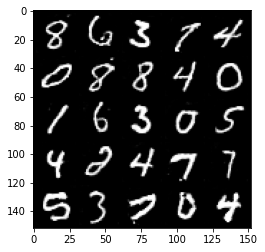

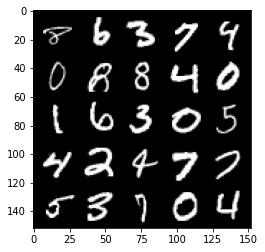

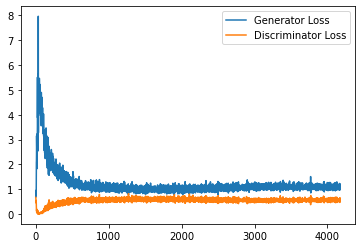

Step 84000: Generator loss: 1.0965085693597794, discriminator loss: 0.5717025446891785


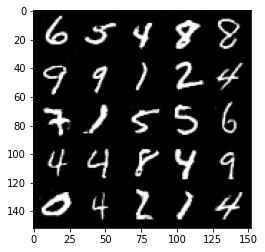

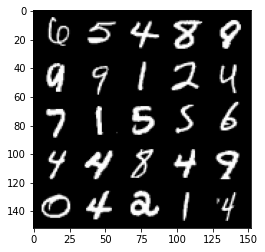

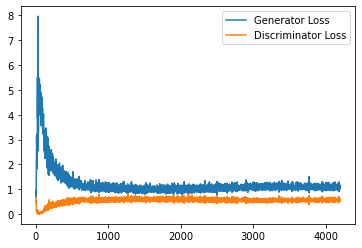

Step 84500: Generator loss: 1.0792039524316788, discriminator loss: 0.5675315453410149


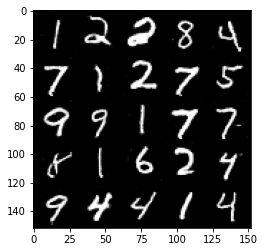

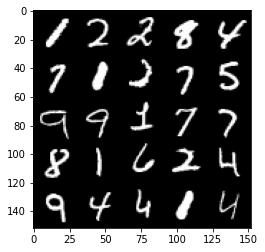

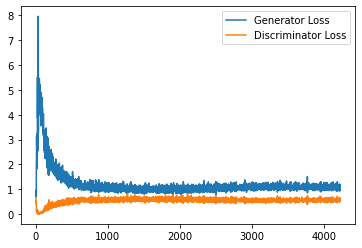

Step 85000: Generator loss: 1.093626844406128, discriminator loss: 0.5713398772478103


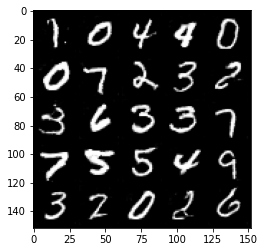

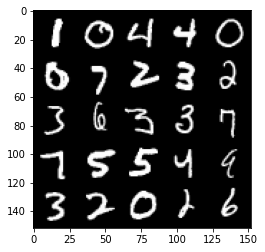

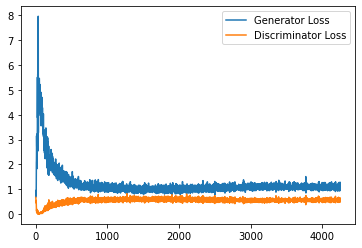

Step 85500: Generator loss: 1.0919418159723282, discriminator loss: 0.5680491591691971


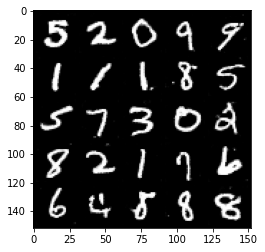

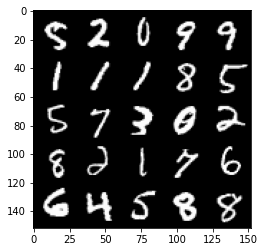

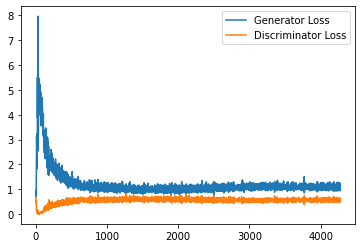

Step 86000: Generator loss: 1.09445632314682, discriminator loss: 0.5686317300200462


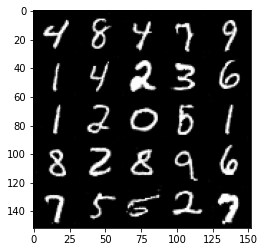

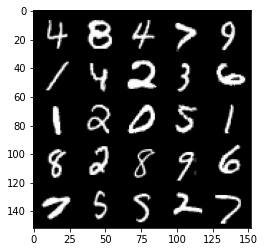

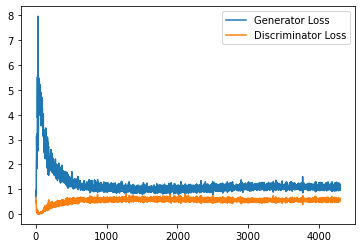

Step 86500: Generator loss: 1.0825012258291244, discriminator loss: 0.5712448297739029


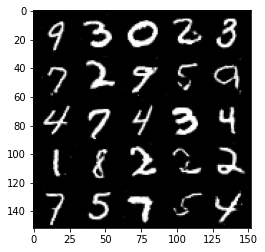

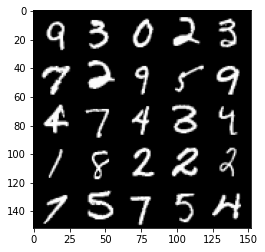

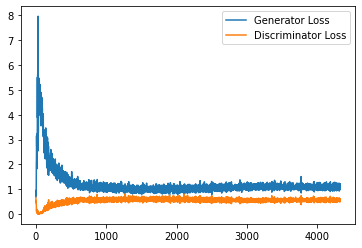

Step 87000: Generator loss: 1.0775316150188445, discriminator loss: 0.5705624576210976


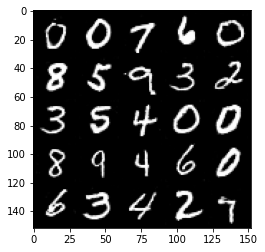

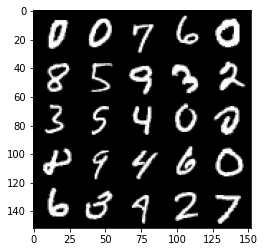

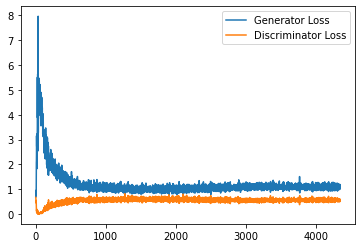

Step 87500: Generator loss: 1.1048589836359024, discriminator loss: 0.5711878029108047


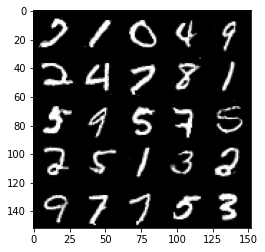

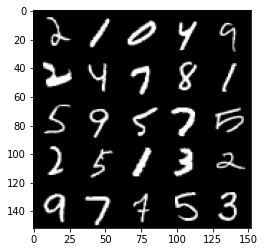

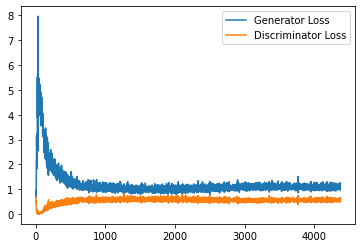

Step 88000: Generator loss: 1.0951422382593154, discriminator loss: 0.5746620658040047


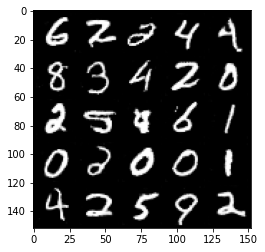

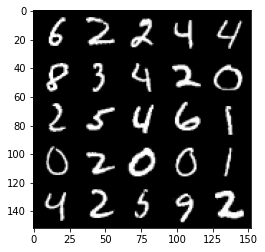

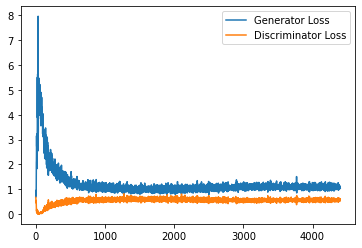

Step 88500: Generator loss: 1.1033170185089112, discriminator loss: 0.5716052258014679


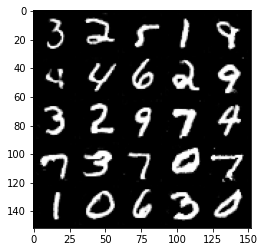

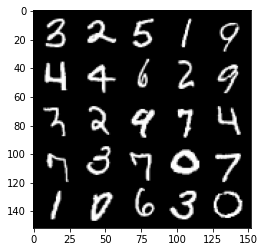

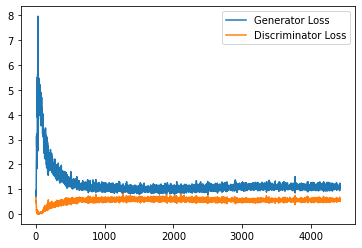

Step 89000: Generator loss: 1.091136212825775, discriminator loss: 0.5784117024540901


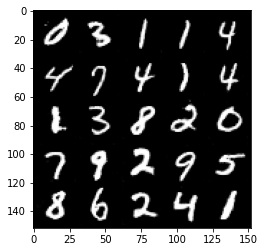

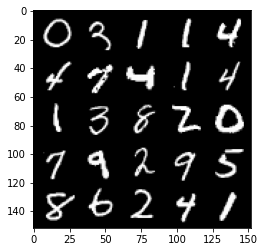

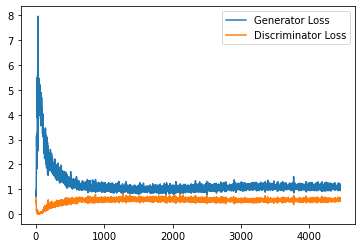

Step 89500: Generator loss: 1.0930120440721511, discriminator loss: 0.574597591638565


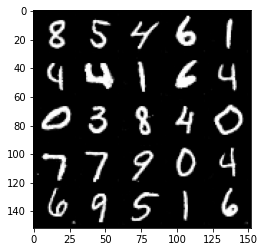

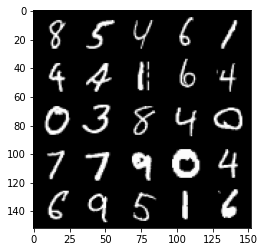

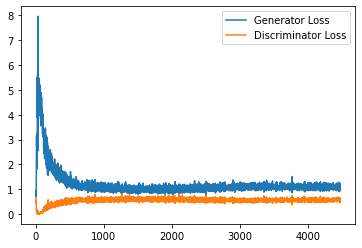

Step 90000: Generator loss: 1.0945774005651474, discriminator loss: 0.5784531397819519


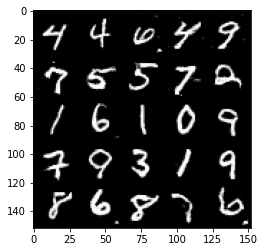

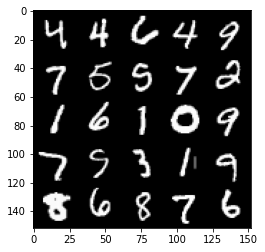

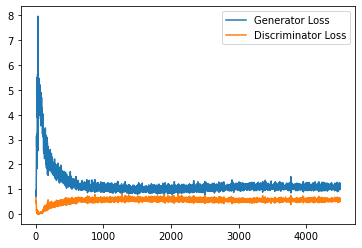

Step 90500: Generator loss: 1.0699443000555038, discriminator loss: 0.5764096970558167


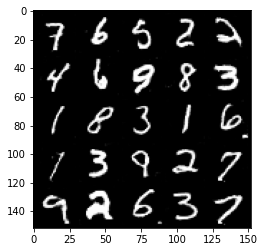

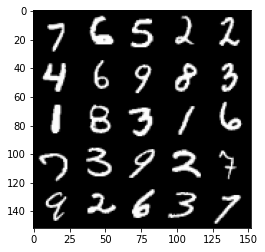

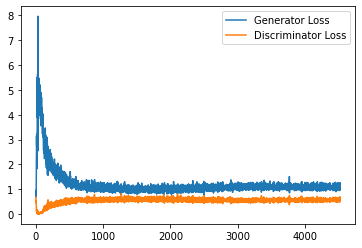

Step 91000: Generator loss: 1.0637339103221892, discriminator loss: 0.5813593348264694


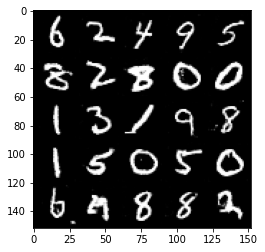

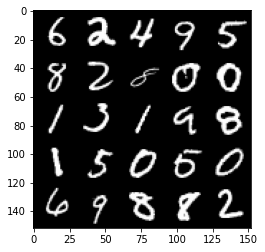

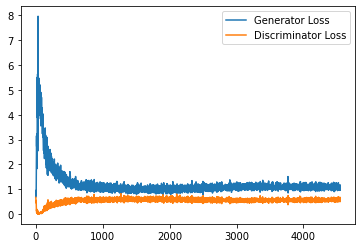

Step 91500: Generator loss: 1.07784616959095, discriminator loss: 0.5758316441774368


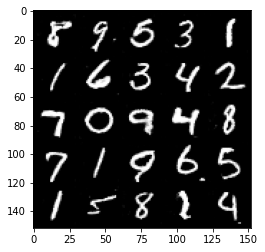

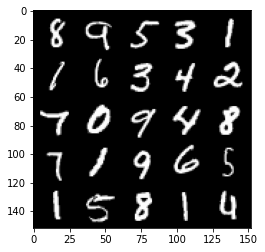

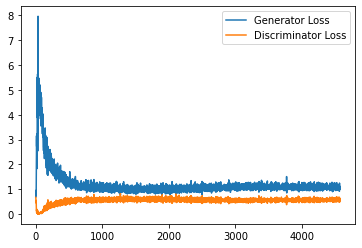

Step 92000: Generator loss: 1.0795238077640534, discriminator loss: 0.5854344654083252


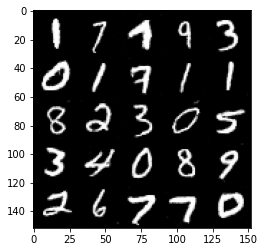

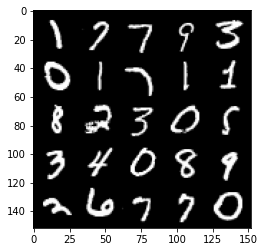

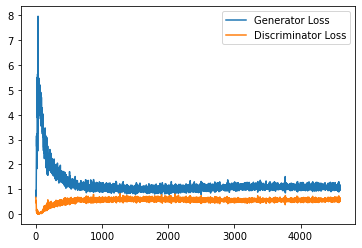

Step 92500: Generator loss: 1.084572160243988, discriminator loss: 0.577184177160263


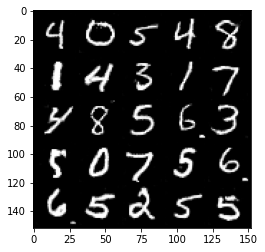

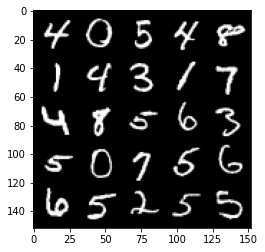

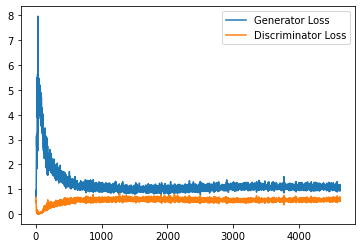

Step 93000: Generator loss: 1.0935532101392746, discriminator loss: 0.5832410217523575


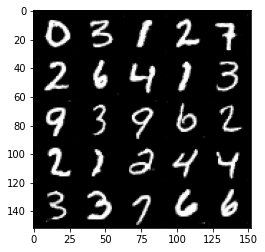

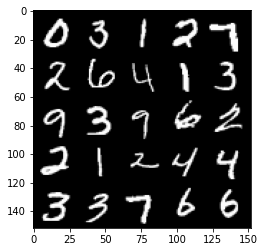

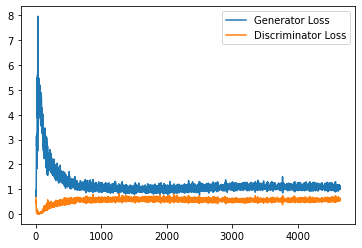

Step 93500: Generator loss: 1.0785085221529007, discriminator loss: 0.5863035295009613


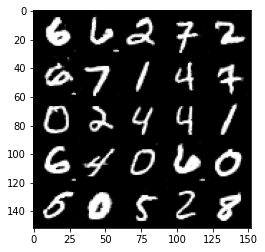

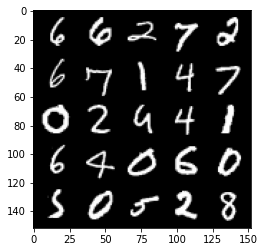

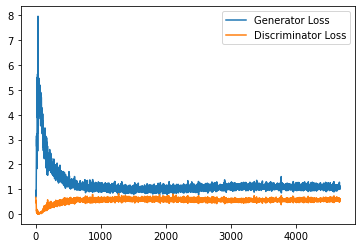

In [ ]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [ ]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

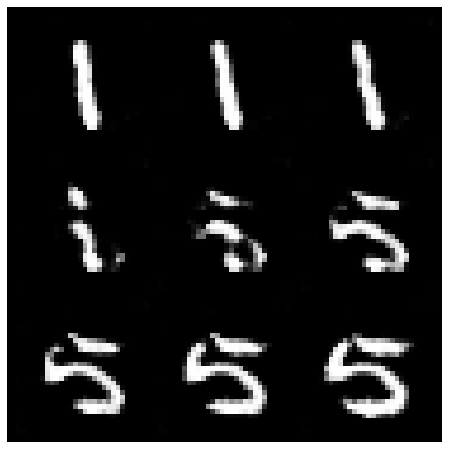

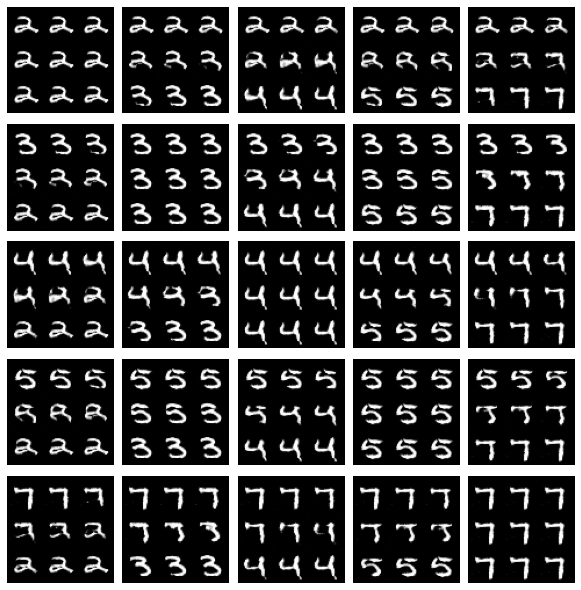

In [ ]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

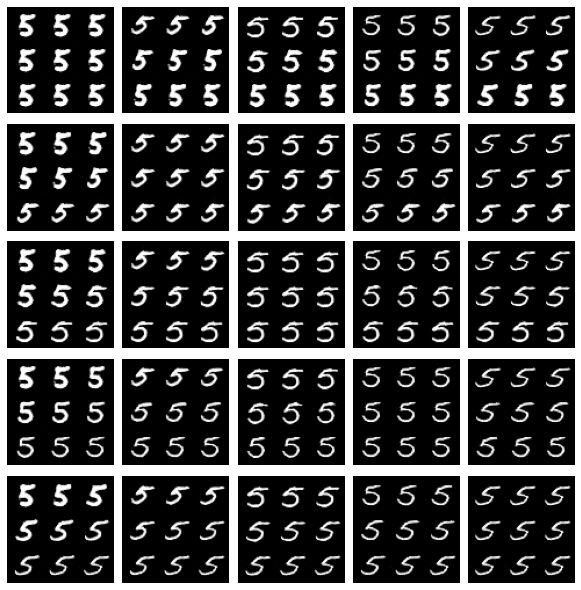

In [ ]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()